In [2]:
import json
import os
import matplotlib.pyplot as plt
import numpy as np
import random
import math
import json
import os
from pathlib import Path
import pulp
from ortools.constraint_solver import pywrapcp
from ortools.sat.python import cp_model
import networkx as nx
import concurrent.futures
import threading
from multiprocessing import Pool
from copy import deepcopy
import gurobipy as gp
from prettytable import PrettyTable
import plotly.graph_objects as go
import matplotlib.colors as mcolors
import colorsys
import numba
from matplotlib.colors import ListedColormap, BoundaryNorm

Restricted license - for non-production use only - expires 2026-11-23
Restricted license - for non-production use only - expires 2026-11-23
Restricted license - for non-production use only - expires 2026-11-23
Restricted license - for non-production use only - expires 2026-11-23
Restricted license - for non-production use only - expires 2026-11-23
Restricted license - for non-production use only - expires 2026-11-23
load C:\Users\MWX1248700\VScodeProjects\mcf_spine_leaf\py_env\Lib\site-packages\ortools\.libs\zlib1.dll...
load C:\Users\MWX1248700\VScodeProjects\mcf_spine_leaf\py_env\Lib\site-packages\ortools\.libs\abseil_dll.dll...
load C:\Users\MWX1248700\VScodeProjects\mcf_spine_leaf\py_env\Lib\site-packages\ortools\.libs\utf8_validity.dll...
load C:\Users\MWX1248700\VScodeProjects\mcf_spine_leaf\py_env\Lib\site-packages\ortools\.libs\re2.dll...
load C:\Users\MWX1248700\VScodeProjects\mcf_spine_leaf\py_env\Lib\site-packages\ortools\.libs\libprotobuf.dll...
load C:\Users\MWX1248700\VSc

In [3]:
alpha_list = [
    "-1.0",
    "-0.9",
    "-0.8",
    "-0.7",
    "-0.6",
    "-0.5",
    "-0.4",
    "-0.3",
    "-0.2",
    "-0.1",
    "0.0",
    "0.1",
    "0.2",
    "0.3",
    "0.4",
    "0.5",
    "0.6",
    "0.7",
    "0.8",
    "0.9",
    "1.0",
]

In [4]:
def get_n_distinct_colors(N):
    # Get all named colors from matplotlib
    all_colors = list(mcolors.CSS4_COLORS.keys())  # or mcolors.TABLEAU_COLORS, XKCD_COLORS for different sets
    
    # If N is larger than available colors, repeat colors or raise error
    if N > len(all_colors):
        raise ValueError(f"Requested {N} colors but only {len(all_colors)} distinct named colors available.")
    
    # Select N colors evenly spaced from the list for better distribution
    indices = np.linspace(0, len(all_colors) - 1, N, dtype=int)
    selected_colors = [all_colors[i] for i in indices]
    return selected_colors

In [5]:
def darken_color(color, amount=0.7):
    """
    Darkens the given color by multiplying its lightness by 'amount' (0 < amount < 1).
    Input can be a matplotlib color string, hex string, or RGB tuple.
    Returns a hex color string.
    """
    try:
        c = mcolors.cnames[color]  # Convert named color to hex
    except KeyError:
        c = color  # Already hex or RGB

    r, g, b = mcolors.to_rgb(c)  # Convert to RGB tuple (0-1)
    h, l, s = colorsys.rgb_to_hls(r, g, b)  # Convert to HLS
    l = max(0, min(1, amount * l))  # Scale lightness and clamp between 0 and 1
    r, g, b = colorsys.hls_to_rgb(h, l, s)  # Convert back to RGB
    return mcolors.to_hex((r, g, b))  # Return hex string

In [6]:
def get_ranking_graph(t, l, s, ranking):
    G = nx.Graph()
    leaves_host_number_on_tasks = [
        [(task, ranking[task][leaf]) for task in range(t)] for leaf in range(l)
    ]
    for leaf in leaves_host_number_on_tasks:
        for task_id, size in leaf:
            for i in range(1, size + 1):
                for j in range(i + 1, size + 1):
                    G.add_edge(f"{task_id}_{i}", f"{task_id}_{j}")
        for from_ in range(0, len(leaf)):
            for to_ in range(from_ + 1, len(leaf)):
                task_from, size_from = leaf[from_]
                task_to, size_to = leaf[to_]
                for i in range(1, size_from + 1):
                    for j in range(1, size_to + 1):
                        G.add_edge(f"{task_from}_{i}", f"{task_to}_{j}")
    return G
def plot_ranking_graph(t,l,s,G_, ranking, figsize = None, coloring=None):
    G = deepcopy(G_)
    for task in range(t):
        G.add_node(f'{task}_0')
    
    length, height = 8,8
    if figsize is not None:
        length, height = figsize
    figsize = (length, height)
    plt.figure(figsize=figsize)
    
    grid_length = t
    grid_height = max([max(rank) for rank in ranking])
    l_step = length/(grid_length+1)
    h_step = height/(grid_height+1)

    pos_dict = {}
    for node in G.nodes:
        task_id, size = list(map(int, node.split('_')))
        node_x, node_y = (task_id+1)*l_step, size*h_step
        if size != 0:
            node_y -= (h_step - 0.4)
        pos_dict[node] = (node_x, node_y)

    node_labels = {node:"" for node in G.nodes}
    # for task, leaf in enumerate(ranking):
    #     for leaf_id, leaf_task in enumerate(leaf):
    #         node_labels[f'{task}_{leaf_task}']+= f'{leaf_id}, '
    node_color = ['#1f78b4' for node in G.nodes]
    if coloring is not None:
        N = len(set(coloring.values()))
        colors = [darken_color(c, 0.6) for c in get_n_distinct_colors(N)]
        node_color = ['#1f78b4' if node.endswith('_0') else colors[coloring[node]] for node in G.nodes]
        node_labels = {node : ('#1f78b4' if node.endswith('_0') else coloring[node]) for node in G.nodes}
    nx.draw_networkx_labels(G, pos=pos_dict, labels=node_labels, font_size=7)
    nx.draw_networkx(G, pos = pos_dict, node_color=node_color, with_labels=False, node_size=500)
    plt.show()

In [7]:
# def get_statistic(stat_name):
#     cwd = os.getcwd()
#     with open(os.path.join(cwd, "statistics", stat_name), "r") as f:
#         res = json.load(f)
#     return res


# def draw_success_part(stat_name):
#     stats = get_statistic(stat_name)
#     n = len(stats)
#     fig, axs = plt.subplots(n, figsize=(10, 8))

#     for plot_id, (config, results) in enumerate(stats.items()):
#         tasks, leaves, spines = eval(config)
#         x = list(map(float, results.keys()))
#         y = [
#             d["passed_tests"] / (d["passed_tests"] + d["failed_tests"])
#             for d in results.values()
#         ]
#         axs[plot_id].scatter(x, y)
#         axs[plot_id].set_title(f"{tasks}_{leaves}_{spines}")
#         axs[plot_id].set_xlabel("alpha")
#         axs[plot_id].set_ylabel("success rate")
#     fig.tight_layout()
#     plt.show()


# def draw_both_scenarios(first_name, second_name):
#     first_stat = get_statistic(first_name)
#     second_stat = get_statistic(second_name)

#     n = len(first_stat)
#     fig, axs = plt.subplots(n, figsize=(15, 13))
#     configs = list(first_stat.keys())
#     for plot_id, config in enumerate(configs):
#         tasks, leaves, spines = eval(config)
#         first_results = first_stat[config]
#         second_results = second_stat[config]

#         x1 = list(map(float, first_results.keys()))
#         y1 = [
#             d["passed_tests"] / (d["passed_tests"] + d["failed_tests"])
#             for d in first_results.values()
#         ]

#         x2 = list(map(float, second_results.keys()))
#         y2 = [
#             d["passed_tests"] / (d["passed_tests"] + d["failed_tests"])
#             for d in second_results.values()
#         ]
#         axs[plot_id].scatter(x1, y1, label=first_name, color="blue")
#         axs[plot_id].scatter(x2, y2, label=second_name, color="red")
#         axs[plot_id].set_title(f"{tasks}_{leaves}_{spines}")
#         axs[plot_id].set_xlabel("alpha")
#         axs[plot_id].set_ylabel("success rate")
#         axs[plot_id].legend()
#     fig.tight_layout()
#     plt.show()


# def draw_all_files(names: list):
#     statistics = [get_statistic(name) for name in names]
#     n = len(names)
#     m = len(statistics[0])
#     configs = sorted(list(statistics[0].keys()))
#     # print(configs)
#     figs, axses = [], []
#     for i in range(0, m, 3):
#         step = min(3, m-i)
#         fig, axs = plt.subplots(step)
#         filename = ''
#         for plot_id, config in enumerate(configs[i:i+step]):
#             tasks, leaves, spines = eval(config)
#             filename += f'({tasks}_{leaves}_{spines})'
#             results = [stat[config] for stat in statistics]
    
#             for j, res in enumerate(results):
#                 x = list(map(float, res.keys()))
#                 y = [
#                     d["passed_tests"] / (d["passed_tests"] + d["failed_tests"])
#                     for d in res.values()
#                 ]
#                 if i in [0, 18]:
#                     axs[plot_id].scatter(x, y, s=9.5, label=f"scenario {j+1}")
#                 else:
#                     axs[plot_id].scatter(x, y, s=9.5)
#             axs[plot_id].grid()
#             axs[plot_id].set_ylim(-0.1, 1.1)
#             axs[plot_id].set_title(f"{tasks} tasks, {leaves} leaves, {spines} spines")
#             axs[plot_id].set_xlabel("alpha")
#             axs[plot_id].set_ylabel("success rate")
#             axs[plot_id].legend()
#             yticks = [0, 0.25, 0.5, 0.75, 1]
#             axs[plot_id].set_yticks(yticks)
#         handles, labels = axs[0].get_legend_handles_labels()
#         if i in [0, 18]:
#             fig.legend(
#                 handles,
#                 labels,
#                 loc="lower left",
#                 bbox_to_anchor=(0, 0),
#                 fontsize=6,
#                 markerscale=0.4,
#             )
#         for ax in axs:
#             ax.get_legend().set_visible(False)
#         fig.tight_layout()
#         fig.savefig(f'{filename}.pdf')
#         figs.append(fig)
#         axses.append(axs)
#     plt.show()


In [8]:
# draw_all_files(
#     ["More_tests_iteration_10000_1.json", "More_tests_iteration_10000_2.json"]
# )

In [9]:
def ranking_is_correct(ranking, spines):
    ranking = np.asarray(ranking)
    tasks = len(ranking)
    leaves = len(ranking[0])
    for leaf_hosts in ranking.sum(axis=0):
        if leaf_hosts > spines:
            return False
    return True


def ranking_is_colored(t, l, s, ranking, need_plot=False, figsize=None):
    G = get_ranking_graph(t, l, s, ranking)

    if need_plot:
        n, e = len(G.nodes), len(G.edges)
        print('nodes', n)
        print('density', 2*e/(n*(n-1)))
        plot_ranking_graph(t,l,s,G, ranking, figsize)

    model = cp_model.CpModel()

    # search_parameters = pywrapcp.DefaultRoutingSearchParameters()
    # search_parameters.time_limit.seconds = 300

    node_order = {node: i for i, node in enumerate(G.nodes())}
    variables = [model.NewIntVar(1, s, node) for node in G.nodes()]
    for u, v in G.edges():
        model.add(variables[node_order[u]] != variables[node_order[v]])
    solver = cp_model.CpSolver()
    # solver.parameters.max_time_in_seconds = 300

    status = solver.solve(model)
    return (status == cp_model.OPTIMAL) or (status == cp_model.FEASIBLE)


def generate_test_alpha(tasks, leaves, spines, alpha=1, task_distribution=None):
    res = []
    bounds = [spines] * leaves
    task_prob = np.ones(leaves, dtype=np.float64)
    for task in range(tasks):
        task_location = [0] * leaves
        # task_prob = np.ones(leaves, dtype=np.float64)
        for leaf in range(leaves):
            if bounds[leaf] == 0:
                task_prob[leaf] = 0
        if task_distribution is None:
            two_power_border = int(
                math.log2(1 + min(max(bounds), sum(bounds) - 2 * (tasks - task - 1)))
            )
            two_power = 2 ** np.random.choice(list(range(1, two_power_border + 1)))
        else:
            two_power = task_distribution[task]
        for host in range(two_power):
            if np.sum(task_prob) == 0:
                break
            host_leaf = np.random.choice(
                np.arange(leaves), p=task_prob / np.sum(task_prob)
            )
            task_location[host_leaf] += 1
            bounds[host_leaf] -= 1
            if bounds[host_leaf] > 0:
                task_prob[host_leaf] = math.e ** (alpha * (spines - bounds[host_leaf]))
            else:
                task_prob[host_leaf] = 0
        res.append(task_location)
    return res


def generate_tests_alpha(
    tasks, leaves, spines, alpha=1, test_num=1, task_distribution=None
):
    ranking = generate_test_alpha(tasks, leaves, spines, alpha, task_distribution)

    if not ranking_is_correct(ranking, spines):
        return None, None
    ranking = sorted(ranking, key=lambda x: sum(x))
    ranking = np.asarray(ranking)
    ranking = ranking[:, ranking.sum(axis=0).argsort()]
    # is_colored = ranking_is_colored(tasks, leaves, spines, ranking, need_plot=True)
    # return ranking, is_colored
    return ranking

In [10]:
def f(tasks, N):
    logN = int(np.log2(N)) + 1
    model = cp_model.CpModel()
    variables = [model.NewIntVar(0, N, str(i)) for i in range(logN - 2)]
    model.maximize(sum([(2 ** (i + 2)) * variables[i] for i in range(0, logN - 2)]))
    model.add(sum([(2 ** (i + 2)) * variables[i] for i in range(0, logN - 2)]) <= N)
    model.add(sum([variables[i] for i in range(logN - 2)]) == tasks)

    solver = cp_model.CpSolver()

    status = solver.solve(model)

    res = []
    for i in range(logN - 2):
        if solver.value(variables[i]) == 0:
            continue
        res += [2 ** (i + 2)] * solver.value(variables[i])

    M = sum(res)
    start = []
    while M > 0:
        num = 2 ** (int(np.log2(M)))
        start.append(num)
        M -= num
    start = sorted(start)
    start = tuple(start)
    res_set = {start}
    for _ in range(tasks - len(start)):
        new_set = set()
        for distr in res_set:
            for i, x in enumerate(distr):
                if x <= 4:
                    continue
                new_distr = list(distr[:i]) + [x // 2, x // 2] + list(distr[i + 1 :])
                new_distr = tuple(sorted(new_distr))
                new_set.add(new_distr)
        res_set = new_set
    res_set = [list(x) for x in res_set]
    return res_set

In [11]:
f(4, 32)

[[8, 8, 8, 8], [4, 4, 8, 16]]

In [12]:
a = {1:2, 3:4}
sum(a.values())

6

In [13]:
def clean_Graph(G:nx.Graph):
    res = {}
    need_stop = True
    
    while need_stop:
        
        need_stop = False
        for u in G.nodes:
            for v in G.nodes:
                n_u = set(G.neighbors(u))
                n_v = set(G.neighbors(v))
                if (u == v) or len(n_u) > len(n_v):
                    continue
                if not n_u.issubset(n_v):
                    continue
                    
                res[u] = v
                arr = list(res.items())
                for delete_node, represent in arr:
                    if represent == u:
                        res[delete_node] = v
                G.remove_node(u)
                
                need_stop = True
                break
            if need_stop:
                break
            
    return res  

In [14]:
# def arep_coloring(G_:nx.Graph, colors:int):
#     G = deepcopy(G_)
#     # dominant_represents = clean_Graph(G)
    
#     node_num = {node:order for order, node in enumerate(G.nodes)}
#     nodes = {order:node for order, node in enumerate(G.nodes)}
    
#     n, e = len(G.nodes), len(G.edges)
#     not_neighbors_more = [[u for u in range(v+1, n) if not G.has_edge(nodes[u], nodes[v])] for v in range(n)]
#     not_neighbors_less = [[u for u in range(v) if not G.has_edge(nodes[u], nodes[v])] for v in range(n)]
#     m = gp.Model()
    
#     represent_vars = [m.addVar(vtype=gp.GRB.BINARY, name=str(i)) for i in range(n)]
#     # color_vars = {(u, v):m.addVar(vtype=gp.GRB.BINARY, name=f'{u}_{v}') for u in range(n) for v in range(u+1, n) if not G.has_edge(nodes[u], nodes[v])}
#     color_vars = {(u, v): m.addVar(vtype=gp.GRB.BINARY, name=f'{u}_{v}') for u in range(n) for v in range(u+1, n)}
#     bad_edges_vars = {(min(node_num[u], node_num[v]), max(node_num[u], node_num[v])):m.addVar(vtype=gp.GRB.BINARY, name=f'{min(node_num[u], node_num[v])}_{max(node_num[u], node_num[v])}') for (u, v) in G.edges}

#     m.setObjective(sum(bad_edges_vars.values()), gp.GRB.MINIMIZE)

#     m.addConstr(
#         sum(represent_vars) <= colors
#     )
    
#     for node in range(n):
#         # m.addConstr(
#         #     sum([color_vars[(u, node)] for u in not_neighbors_less[node]]) + represent_vars[node] >= 1
#         # )
#         m.addConstr(
#             sum([color_vars[(u, node)] for u in range(node)]) + represent_vars[node] >= 1
#         )
#     for (u, v) in G.edges:
#         u_num, v_num = min(node_num[u], node_num[v]), max(node_num[u], node_num[v])
#         m.addConstr(
#             bad_edges_vars[(u_num, v_num)] - color_vars[(u_num, v_num)] >= 0
#         )
#     # for u in range(n):
#     #     for i, v in enumerate(not_neighbors_more[u]):
#     #         for w in not_neighbors_more[u][i+1:]:
#     #             if v == w:
#     #                 continue
#     #             if not G.has_edge(nodes[w], nodes[v]):
#     #                 continue
#     #             if v > w:
#     #                 v,w = w,v
#     #             m.addConstr(
#     #                 color_vars[(u,v)] + color_vars[(u,w)] - represent_vars[u] - bad_edges_vars[(v,w)] <= 0
#     #             )
#     for u in range(n):
#         for v in range(u+1, n):
#             for w in range(v+1, n):
#                 if not G.has_edge(nodes[w], nodes[v]):
#                     continue
#                 m.addConstr(
#                     color_vars[(u,v)] + color_vars[(u,w)] - represent_vars[u] - bad_edges_vars[(v,w)] <= 0
#                 )
#     m.optimize()

#     represents = [u for u in range(n) if represent_vars[u].X==1]
#     represents = {x:i for i, x in enumerate(represents)}
    
#     final_colors = []
#     for node in range(n):
#         if represent_vars[node].X==1:
#             final_colors.append(represents[node])
#             continue
#         # for u in not_neighbors_less[node]:
#         #     if color_vars[(u, node)].X == 1:
#         #         final_colors.append(represents[u])
#         #         break
#         for u in range(node):
#             if color_vars[(u, node)].X == 1:
#                 final_colors.append(represents[u])
#                 break
#     final_colors = {node: final_colors[i] for i, node in enumerate(G.nodes)}
#     # for deleted, dominant in dominant_represents.items():
#     #     final_colors[deleted] = final_colors[dominant]
#     return m, represent_vars, color_vars, bad_edges_vars, final_colors

In [15]:
def assign_coloring(G_:nx.Graph, colors:int):
    G = deepcopy(G_)
    # dominant_represents = clean_Graph(G)
    
    node_num = {node:order for order, node in enumerate(G.nodes)}
    nodes = {order:node for order, node in enumerate(G.nodes)}
    
    n, e = len(G.nodes), len(G.edges)
    not_neighbors_more = [[u for u in range(v+1, n) if not G.has_edge(nodes[u], nodes[v])] for v in range(n)]
    not_neighbors_less = [[u for u in range(v) if not G.has_edge(nodes[u], nodes[v])] for v in range(n)]
    m = gp.Model()
    color_vars = {(v, color): m.addVar(vtype=gp.GRB.BINARY, name=f'{v}_{color}_c') for v in range(n) for color in range(colors)}
    bad_edges_vars = {(min(node_num[u], node_num[v]), max(node_num[u], node_num[v])):m.addVar(vtype=gp.GRB.BINARY, name=f'{min(node_num[u], node_num[v])}_{max(node_num[u], node_num[v])}_b') for (u, v) in G.edges}
    used_colors_vars = [m.addVar(vtype=gp.GRB.BINARY, name=f'{color}_color') for color in range(colors)]
    
    m.setObjective(sum(bad_edges_vars.values()), gp.GRB.MINIMIZE)
    for node in range(n):
        m.addConstr(
            sum([color_vars[(node, color)] for color in range(colors)]) == 1
        )
    for (u, v) in G.edges:
        u_num, v_num = min(node_num[u], node_num[v]), max(node_num[u], node_num[v])
        for color in range(colors):
            m.addConstr(
                color_vars[(u_num, color)] + color_vars[(v_num, color)] - used_colors_vars[color] - bad_edges_vars[(u_num, v_num)] <= 0
            )
    for color in range(colors):
        m.addConstr(
              sum([color_vars[(node, color)] for node in range(n)]) - used_colors_vars[color] >= 0
        )
    for color in range(1, colors):
        used_colors_vars[color] - used_colors_vars[color-1] <= 0
    m.optimize()

    final_colors = [0] * n
    for node in range(n):
        for color in range(colors):
            if color_vars[(node, color)].X == 1:
                final_colors[node] = color
                
    final_colors = {node: final_colors[i] for i, node in enumerate(G.nodes)}
    return final_colors

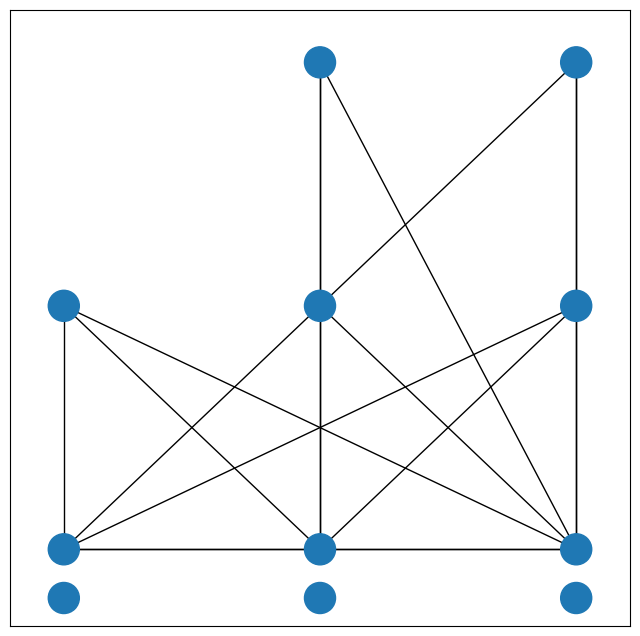

In [16]:
t,l,s,ranking = 3,8,4,[[1, 1, 1, 1, 2, 0, 1, 1],[0, 0, 1, 1, 1, 3, 1, 1],[3, 3, 2, 2, 1, 1, 2, 2]]
G = get_ranking_graph(t, l, s, ranking)
plot_ranking_graph(t,l,s,G, ranking)

In [17]:
def arep_ranking_coloring(t, l, s, ranking):
    G = get_ranking_graph(t, l, s, ranking)
    final_colors = arep_coloring(G, s)
    print("\n------\n")
    nodes = [v for v in G.nodes]
    broken_edges = 0
    for (u, v) in G.edges:
        if final_colors[u] != final_colors[v]:
            continue
        broken_edges += 1
        print(u,v)
    print(f"broken edges {broken_edges}")
    return final_colors

In [18]:
def assign_ranking_coloring(t, l, s, ranking):
    G = get_ranking_graph(t, l, s, ranking)
    final_colors = assign_coloring(G, s)
    print("\n------\n")
    nodes = [v for v in G.nodes]
    broken_edges = 0
    for (u, v) in G.edges:
        if final_colors[u] != final_colors[v]:
            continue
        broken_edges += 1
        print(u,v)
    print(f"broken edges {broken_edges}")
    return final_colors

In [19]:
test_ranking = [[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 3, 0, 0, 0],
   [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 0, 0, 0],
   [3, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
   [4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
   [0, 1, 0, 0, 0, 0, 0, 0, 7, 1, 2, 0, 0, 0, 2, 3],
   [0, 7, 0, 2, 0, 1, 0, 1, 0, 4, 6, 2, 0, 0, 4, 5],
   [1, 0, 8, 5, 8, 7, 8, 7, 0, 3, 0, 6, 1, 8, 2, 0]]
final_colors = assign_ranking_coloring(7, 16, 8, test_ranking)
final_colors

Restricted license - for non-production use only - expires 2026-11-23
Gurobi Optimizer version 12.0.2 build v12.0.2rc0 (win64 - Windows 10.0 (19045.2))

CPU model: Intel(R) Core(TM) i7-8665U CPU @ 1.90GHz, instruction set [SSE2|AVX|AVX2]
Thread count: 4 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1492 rows, 477 columns and 6376 nonzeros
Model fingerprint: 0x26d14373
Variable types: 0 continuous, 477 integer (477 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+00, 1e+00]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective 172.0000000
Presolve time: 0.02s
Presolved: 1492 rows, 477 columns, 6376 nonzeros
Variable types: 0 continuous, 477 integer (477 binary)

Root relaxation: objective 0.000000e+00, 187 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incum

{'2_1': 5,
 '2_2': 2,
 '2_3': 1,
 '3_1': 6,
 '3_2': 0,
 '3_3': 3,
 '3_4': 7,
 '6_1': 4,
 '5_1': 3,
 '5_2': 1,
 '5_3': 7,
 '5_4': 0,
 '5_5': 4,
 '5_6': 2,
 '5_7': 6,
 '4_1': 5,
 '6_2': 2,
 '6_3': 6,
 '6_4': 7,
 '6_5': 0,
 '6_6': 5,
 '6_7': 1,
 '6_8': 3,
 '4_2': 6,
 '4_3': 2,
 '4_4': 1,
 '4_5': 4,
 '4_6': 0,
 '4_7': 3,
 '0_1': 7,
 '0_2': 3,
 '0_3': 6,
 '1_1': 0,
 '1_2': 5,
 '1_3': 1,
 '1_4': 2}

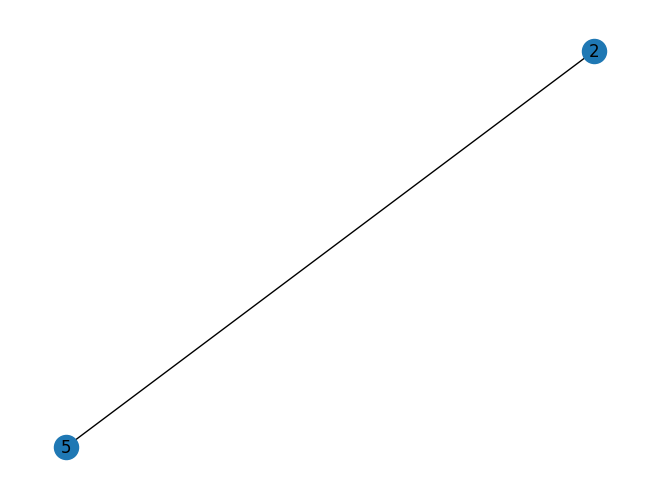

{0: 5, 1: 2, 3: 5, 4: 5}

In [20]:
G = nx.Graph()
G.add_nodes_from(range(6))
G.add_edges_from([(1,3), (1,4), (1,5), (2,3), (2,4), (2,5), (2,0)])
res = clean_Graph(G)
nx.draw(G, with_labels=True)
plt.show()
res

In [21]:
# G = nx.Graph()
# G.add_nodes_from(range(7))
# G.add_edges_from([(1,2), (1,3), (2,3), (2,4), (3,4), (4,5), (4,6), (5,6), (5,0), (6,0), (1,0)])
# model, represent_vars, color_vars, bad_edges_vars, colors = assign_ranking_coloring(G, 3)
# print(f'\nbad_edges {model.objVal}')
# print('represent_vars')
# for i, v in enumerate(represent_vars):
#     print(i, v.X)
# print('\n\n----')


# print('color_vars')
# for k, v in color_vars.items():
#     print(k, v.X)
# print('\n\n----')

# print('bad_edges_vars')
# for k, v in bad_edges_vars.items():
#     print(k, v.X)
# print('\n\n---')
# print('colors', colors)

In [22]:
def interval_ranking_coloring(t,l,s, ranking):
    layers = {}
    leaf_to_layers = [[] for leaf in range(l)]
    for task in range(t):
        H = max(ranking[task])
        
        for leaf in range(l):
            for size in range(1, ranking[task][leaf]+1):
                if f'{task}_{size}' not in layers:
                    layers[f'{task}_{size}'] = set()
                layers[f'{task}_{size}'].add(leaf)
                leaf_to_layers[leaf].append(f'{task}_{size}')
    G = get_ranking_graph(t, l, s, ranking)
    coloring = {}
    for leaf in range(l):
        for leaf_layer in leaf_to_layers[leaf]:
            if leaf_layer in coloring:
                continue
            used_colors = {coloring[node] for node in G.neighbors(leaf_layer) if node in coloring}
            color_cnt = 0
            while color_cnt in used_colors:
                color_cnt += 1
            coloring[leaf_layer] = color_cnt
    return layers, leaf_to_layers, coloring

In [23]:
np.random.choice(list(range(4)), 2, replace=False)

array([2, 1])

In [24]:
a = np.array([np.array([1,2]),np.array([3,4]),np.array([5,6])])
b = np.array([np.array([1,2]),np.array([3,4]),np.array([5,6])])
(a - b).any() == 0

np.True_

In [25]:
def get_neighbor_ranking(t, l, s, ranking: np.ndarray) -> np.ndarray:
    tasks_pairs = []

    for t1 in range(t):
        for t2 in range(t1 + 1, t):
            # Boolean masks for leaves
            l1_mask = (ranking[t1] < s) & (ranking[t2] > 0)
            l2_mask = (ranking[t1] > 0) & (ranking[t2] < s)

            l1_cnt = np.where(l1_mask)[0]
            l2_cnt = np.where(l2_mask)[0]

            if l1_cnt.size == 0 or l2_cnt.size == 0:
                continue

            # Skip if l1_cnt == l2_cnt and length == 1
            if l1_cnt.size == 1 and np.array_equal(l1_cnt, l2_cnt):
                continue

            # Calculate potentials and probabilities
            # For each element in l1_cnt, count how many elements in l2_cnt are greater
            indices = np.searchsorted(l2_cnt, l1_cnt, side='right')
            counts = l2_cnt.size - indices
            p = counts.sum()

            if p == 0:
                continue

            tasks_pairs.append((t1, t2, p, l1_cnt, counts))

    if not tasks_pairs:
        return ranking.copy()

    # Normalize probabilities for task pairs
    p_vals = np.array([x[2] for x in tasks_pairs], dtype=np.float64)
    p_vals /= p_vals.sum()

    # Select a task pair randomly weighted by p_vals
    idx = np.random.choice(len(tasks_pairs), p=p_vals)
    t1, t2, prob, l1_potentials, probs1 = tasks_pairs[idx]

    # Normalize probabilities for l1_potentials
    probs1_norm = probs1 / probs1.sum()
    l1 = np.random.choice(l1_potentials, p=probs1_norm)

    # Select l2 candidates satisfying constraints
    l2_candidates_mask = (np.arange(l) > l1) & (ranking[t2] < s) & (ranking[t1] > 0)
    l2_candidates = np.where(l2_candidates_mask)[0]

    if l2_candidates.size == 0:
        return ranking.copy()

    l2 = np.random.choice(l2_candidates)

    # Create a copy of ranking and update
    new_ranking = ranking.copy()
    new_ranking[t1, l1] += 1
    new_ranking[t1, l2] -= 1
    new_ranking[t2, l1] -= 1
    new_ranking[t2, l2] += 1

    return new_ranking

In [26]:
a = np.array([1,2,3])
set(a)

{np.int64(1), np.int64(2), np.int64(3)}

In [27]:
def top_k_elements(arr, k=3):
    arr = np.array(arr)
    # Get indices of top k elements (unsorted)
    idx_unsorted = np.argpartition(arr, -k)[-k:]
    # Sort these indices by their values in descending order
    idx_sorted = idx_unsorted[np.argsort(arr[idx_unsorted])[::-1]]
    top_values = arr[idx_sorted]
    return idx_sorted, top_values

def get_neighbor_ranking_sily(t,l,s,ranking):
    neighborhood = []
    for t1 in range(t):
        for t2 in range(t1+1, t):

            # _, max_1 = top_k_elements(ranking[t1])
            # _, max_2 = top_k_elements(ranking[t2])
            max_1 = max(ranking[t1])
            max_2 = max(ranking[t2])
            
            l1_max = set([leaf for leaf in range(l) if ranking[t1][leaf] == max_1 and ranking[t2][leaf] < s])
            l2_max = set([leaf for leaf in range(l) if ranking[t2][leaf] == max_2 and ranking[t1][leaf] < s])
            if len(l1_max) > 0 and len(l2_max) > 0:
                if (l1_max == l2_max) and len(l1_max) == 1:
                    continue
                 
                common = len(l1_max & l2_max)

                
                neighborhood.append([t1, t2, len(l1_max)*len(l2_max) - common])

    if len(neighborhood) == 0:
        return ranking
    p = [x[2] for x in neighborhood]
    all_sum = sum(p)
    p = [x/all_sum for x in p]
    pos = np.random.choice(list(range(len(neighborhood))), p=p)
    
    t1, t2, _ = neighborhood[pos]
    # _, max_1 = top_k_elements(ranking[t1])
    # _, max_2 = top_k_elements(ranking[t2])
    max_1 = max(ranking[t1])
    max_2 = max(ranking[t2])
    l1_max = list([leaf for leaf in range(l) if ranking[t1][leaf] == max_1 and ranking[t2][leaf] < s])
    l2_max = list([leaf for leaf in range(l) if ranking[t2][leaf] == max_2 and ranking[t1][leaf] < s])

    l1,l2=None,None
    if len(l1_max) == 1:
        l1 = l1_max[0]
        if l1 in l2_max:
            l2_max.remove(l1)
        l2 = np.random.choice(l2_max)
    elif len(l2_max) == 1:
        l2 = l2_max[0]
        if l2 in l1_max:
            l1_max.remove(l2)
        l1 = np.random.choice(l1_max)
    else:
        l1 = np.random.choice(l1_max)
        if l1 in l2_max:
            l2_max.remove(l1)
        l2 = np.random.choice(l2_max)
        

    
        
    new_ranking = deepcopy(ranking)
    new_ranking[t1][l1] -= 1
    new_ranking[t1][l2] += 1
    new_ranking[t2][l1] += 1
    new_ranking[t2][l2] -= 1
    return new_ranking

In [28]:
# def get_neighbor_ranking_sily(t,l,s,ranking):
#     neighborhood = []
#     for t1 in range(t):
#         for t2 in range(t):
#             if t1==t2:
#                 continue
#             max_1 = max(ranking[t1])
#             max_2 = max(ranking[t2])
#             for l1 in range(l):
#                 if ranking[t1][l1] != max_1:
#                     continue
#                 for l2 in range(l):
#                     if ranking[t2][l2] != max_2:
#                         continue
#                     if ranking[t1][l2] < s and ranking[t2][l1] < s:
#                         neighborhood.append((t1, t2, l1, l2))
#     if len(neighborhood) == 0:
#         return deepcopy(ranking)
#     pos = np.random.choice(list(range(len(neighborhood))))
#     t1, t2, l1, l2 = neighborhood[pos]
        
#     new_ranking = deepcopy(ranking)
#     new_ranking[t1][l1] -= 1
#     new_ranking[t1][l2] += 1
#     new_ranking[t2][l1] += 1
#     new_ranking[t2][l2] -= 1
#     return new_ranking

In [29]:
def count_colors(t,l,s,ranking):
    _, _, coloring = interval_ranking_coloring(t,l,s, ranking)
    return len(set(coloring.values()))

    
def simulated_anealling(t,l,s,ranking, get_new_ranking, max_iter=10000):
    colors = count_colors(t,l,s,ranking)
    for i in range(max_iter):
        if colors <= s:
            print(f'finished in {i} iterations')
            break
        T = max_iter/(i+1)
        new_ranking = get_new_ranking(t,l,s,ranking)
        if (new_ranking-ranking).any() == 0:
            print(f'finished in {i} iterations')
            break
        new_colors = count_colors(t,l,s,new_ranking)
        if new_colors < colors:
            colors = new_colors
            ranking = deepcopy(new_ranking)
            continue

        if np.pow(np.e, (colors-new_colors)/T) > np.random.uniform(0,1):
            colors = new_colors
            ranking = deepcopy(new_ranking)
            continue
    return ranking, colors

In [30]:
def pretty_ranking(t,l,s,ranking):
    table = PrettyTable()
    table.field_names = [""] + [f"l {leaf}" for leaf in range(l)]
    for task_id, task in enumerate(ranking):
        table.add_row([f"t {task_id}"] + list(map(str, task)))
    print(table)

In [84]:
def plot_ranking(t,l,s,ranking):
    # Suppose your array is called data (shape 9x64)
    data = ranking
    row_sums = data.sum(axis=1)
    col_sums = data.sum(axis=0)
    
    fig, ax = plt.subplots(figsize=(20, 6))
    
    # Show the 2D array as an image
    norm = mcolors.Normalize(vmin=0, vmax=s)
    im = ax.imshow(data, aspect='auto', cmap='viridis', norm=norm)
    
    # Add a colorbar
    plt.colorbar(im, ax=ax, fraction=0.02, pad=0.04)
    
    # Set labels and title
    ax.set_xlabel('Column Index')
    ax.set_ylabel('Row Index')
    ax.set_title('2D Array with Row Sums')
    
    # Remove ticks if you want cleaner look
    ax.set_xticks(np.arange(data.shape[1]))
    ax.set_yticks(np.arange(data.shape[0]))
    
    # Optionally, hide tick labels for columns if too dense
    # ax.set_xticklabels([])
    # ax.set_yticklabels(np.arange(data.shape[0]))

    for i in range(data.shape[0]):
        for j in range(data.shape[1]):
            val = data[i, j]
            if val != 0:
                ax.text(j, i, f'{val}', ha='center', va='center', color='black', fontsize=12)
    
    # Annotate sums to the right of each row
    for i, total in enumerate(row_sums):
        # Place text slightly to the right of the last column (index data.shape[1]-1)
        ax.text(data.shape[1] + 0.2, i, f'{total}', va='center', ha='left', fontsize=12, color='black')
        
    for j, total in enumerate(col_sums):
        ax.text(j, data.shape[0] + 0.7, f'{total}', va='top', ha='center', fontsize=12, color='black')
    
    # Adjust x-axis limits to make space for the sums
    # ax.set_xlim(-0.5, data.shape[1] + 5)  # Extend right limit to fit sums
    # ax.set_ylim(data.shape[0] + 1, -0.5)
    
    plt.tight_layout()
    plt.show()

In [109]:
def assignment_board(T, l, s, ranking):
    data = np.zeros((s, l))
    for leaf in range(l):
        ptr = 0
        for task in range(T):
            size = ranking[task][leaf]
            data[ptr : ptr + size, leaf] = np.full(size, task)
            ptr += size
    print(data.shape)
    # return data
    # color_list = ['gray', 'red', 'green', 'blue', 'yellow', 'purple']  # length = T+1
    color_list = [darken_color(c, 0.6) for c in get_n_distinct_colors(T)]
    # Create a ListedColormap
    cmap = ListedColormap(color_list)

    # Define boundaries and normalization for discrete colors
    bounds = np.arange(-0.5, T, 1)
    norm = BoundaryNorm(bounds, cmap.N)
    
    fig, ax = plt.subplots(figsize=(20, 10))
    im = ax.imshow(data, cmap=cmap, norm=norm, interpolation='none', aspect='auto')
    
    # Set ticks at every column and row
    ax.set_xticks(np.arange(data.shape[1]))
    ax.set_yticks(np.arange(data.shape[0]))
    
    # Optionally, label ticks with their indices (or custom labels)
    ax.set_xticklabels(np.arange(data.shape[1]))
    ax.set_yticklabels(np.arange(data.shape[0]))

    # ax.tick_params(axis='y', pad=10)
    # # Move x tick labels rightward by increasing padding
    # ax.tick_params(axis='x', pad=10)
    
    # Optionally, rotate x tick labels for better readability
    plt.setp(ax.get_xticklabels(), rotation=45, ha='right')
    
    # Add gridlines to separate cells clearly
    ax.grid(which='both', color='black', linestyle='-', linewidth=1)
    # ax.set_xticks(np.arange(l))
    # ax.set_yticks(np.arange(s))
    ax.set_xticks(np.arange(-0.5, data.shape[1], 1), minor=True)
    ax.set_yticks(np.arange(-0.5, data.shape[0], 1), minor=True)

    ax.grid(which='minor', color='black', linestyle='-', linewidth=1)
    
    # Add colorbar
    cbar = fig.colorbar(im, ticks=np.arange(T))
    cbar.set_label('Value')
    cbar.ax.set_yticklabels([str(i) for i in range(T)])
    
    plt.title('Assigning Hosts to Tasks')
    plt.xlabel('Leaves')
    plt.ylabel('Hosts')
    plt.tight_layout()
    plt.show()

In [115]:
def make_test(t,l,s,task_distribution,alpha, get_new_ranking):
    start_ranking = generate_tests_alpha(t, l, s, alpha=alpha, test_num=1, task_distribution=task_distribution)

    plot_ranking(t,l,s,start_ranking)
    _, _, coloring = interval_ranking_coloring(t,l,s,start_ranking)
    print('greedy_colors', len(set(coloring.values())))
    G = get_ranking_graph(t, l, s, start_ranking)
    print('nodes', len(G.nodes), 'density', 2*len(G.edges)/(len(G.nodes)*(len(G.nodes)-1)))
    plot_ranking_graph(t,l,s,G, start_ranking, figsize = (20, 10), coloring=coloring)
    print('\n\n-----------------\n\n')
    
    ranking, colors = simulated_anealling(t,l,s,start_ranking, get_new_ranking, max_iter=10000)
    plot_ranking(t,l,s,ranking)
    _, _, coloring = interval_ranking_coloring(t,l,s,ranking)
    print('greedy_colors', len(set(coloring.values())))
    G = get_ranking_graph(t, l, s, ranking)
    print('nodes', len(G.nodes), 'density', 2*len(G.edges)/(len(G.nodes)*(len(G.nodes)-1)))
    plot_ranking_graph(t,l,s,G, ranking, figsize = (20, 10), coloring=coloring)
    if len(set(coloring.values())) <= s:
        assignment_board(t, l, s, ranking)
    return ranking, coloring
    print('\n\n-----------------\n\n')

2 32 16


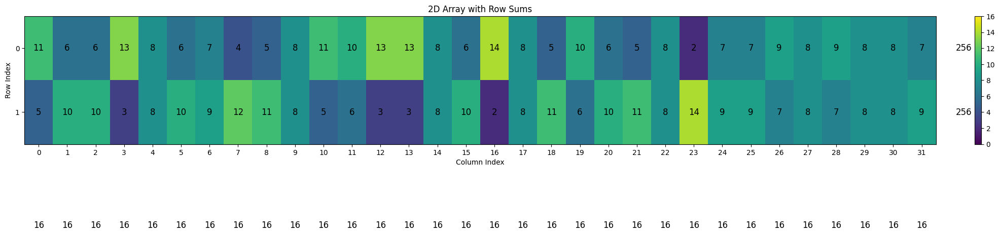

greedy_colors 16
nodes 28 density 0.7883597883597884


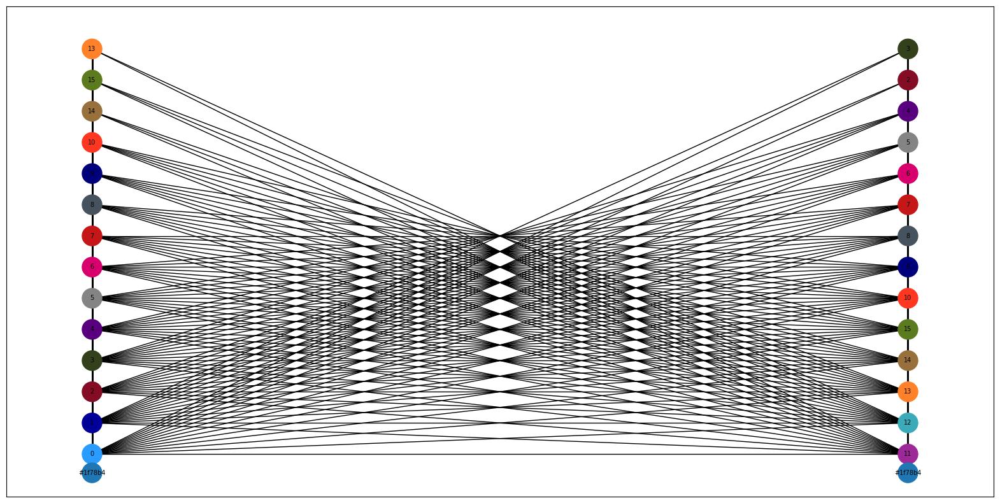



-----------------


finished in 0 iterations


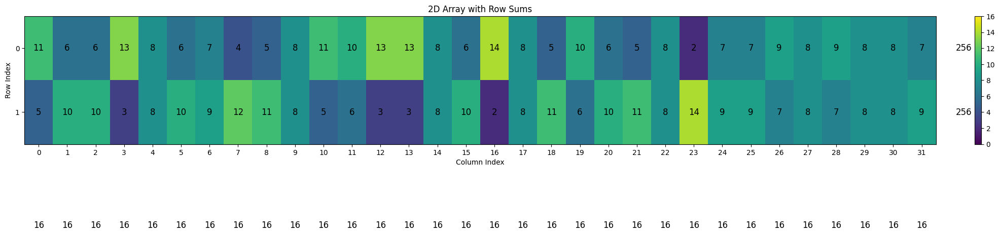

greedy_colors 16
nodes 28 density 0.7883597883597884


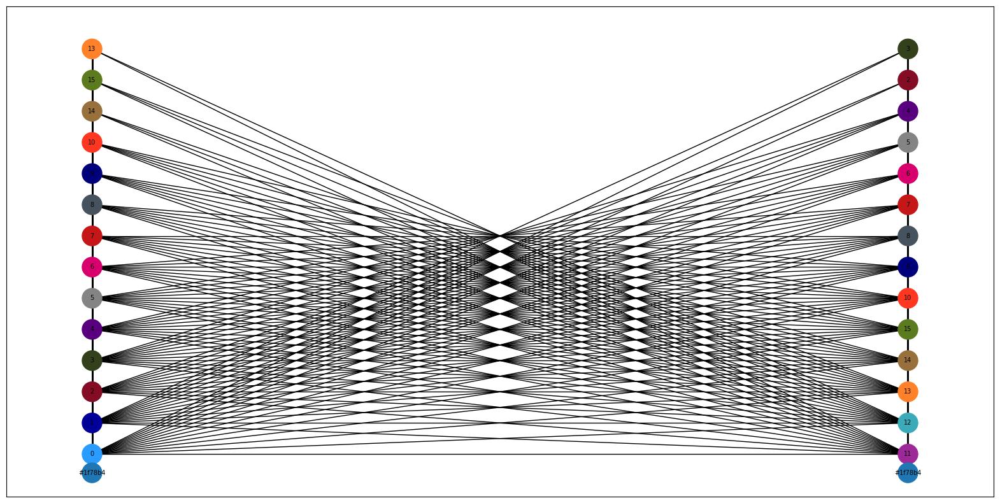

(16, 32)


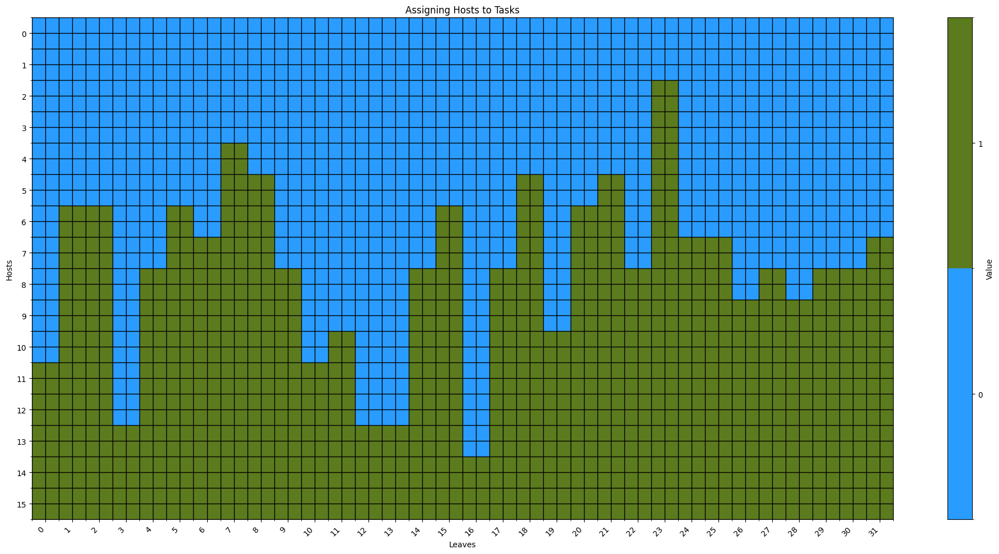

3 32 16


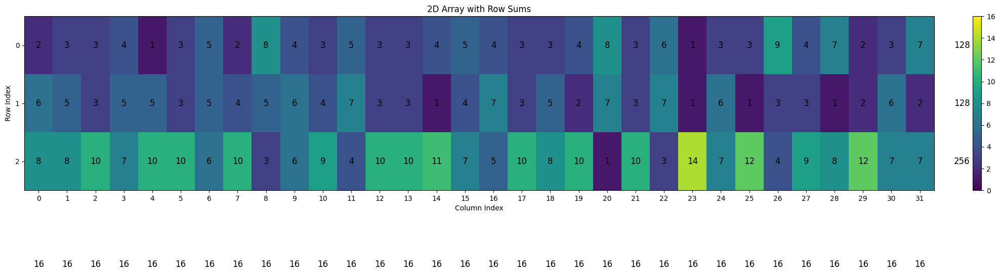

greedy_colors 21
nodes 30 density 0.8206896551724138


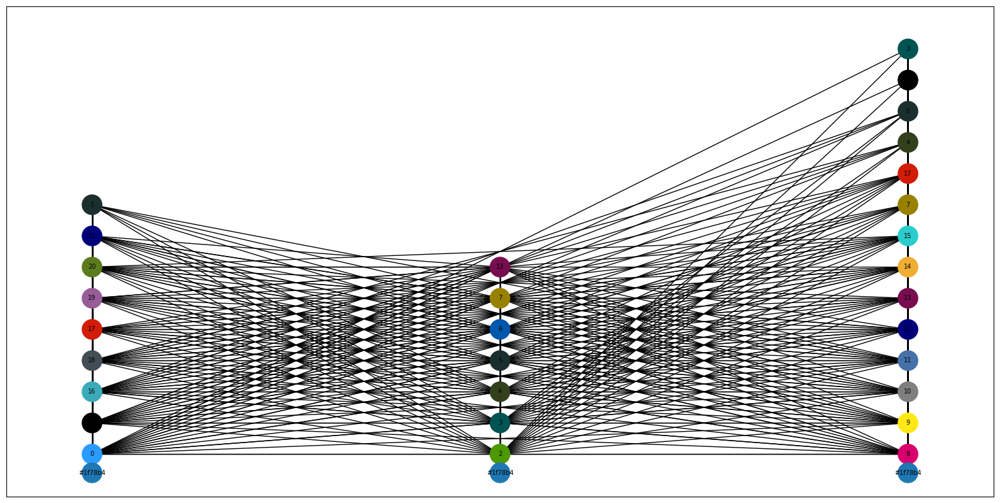



-----------------


finished in 60 iterations


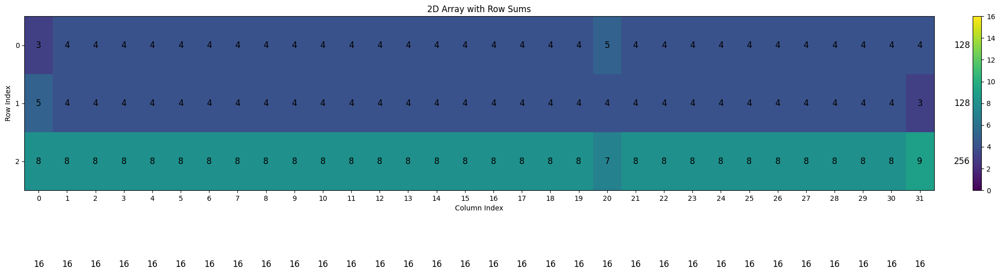

greedy_colors 16
nodes 19 density 0.9649122807017544


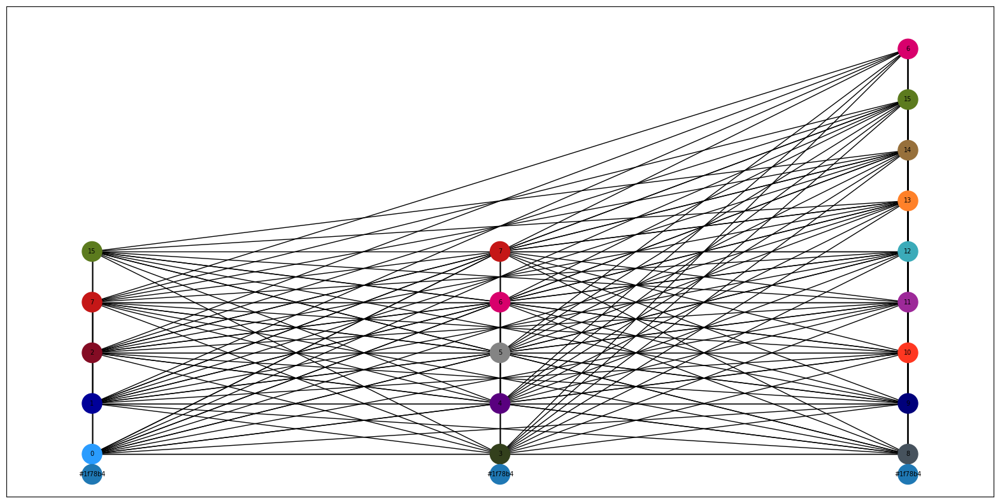

(16, 32)


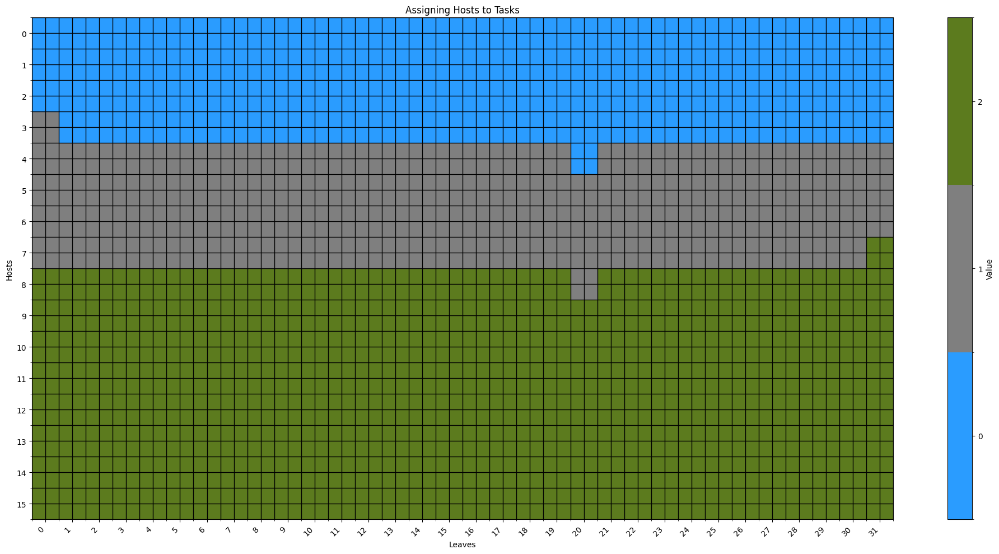

4 32 16


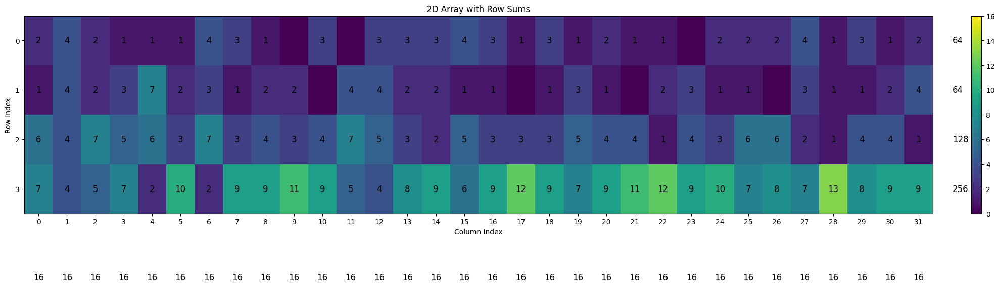

greedy_colors 21
nodes 31 density 0.8086021505376344


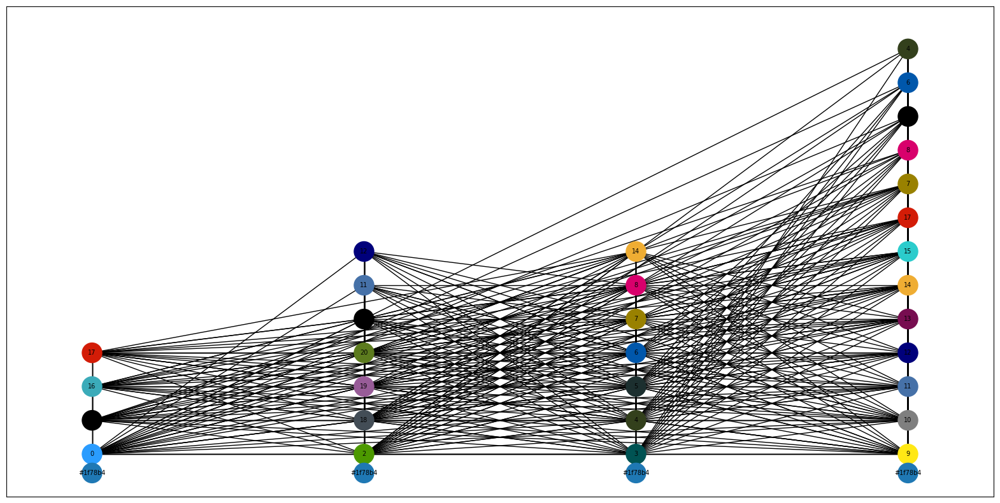



-----------------


finished in 112 iterations


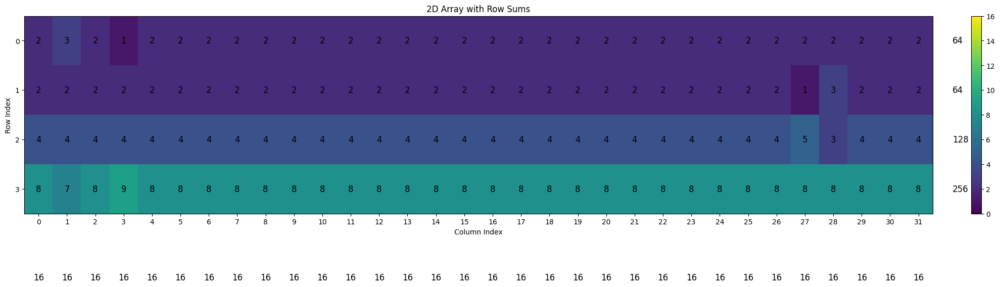

greedy_colors 16
nodes 20 density 0.9473684210526315


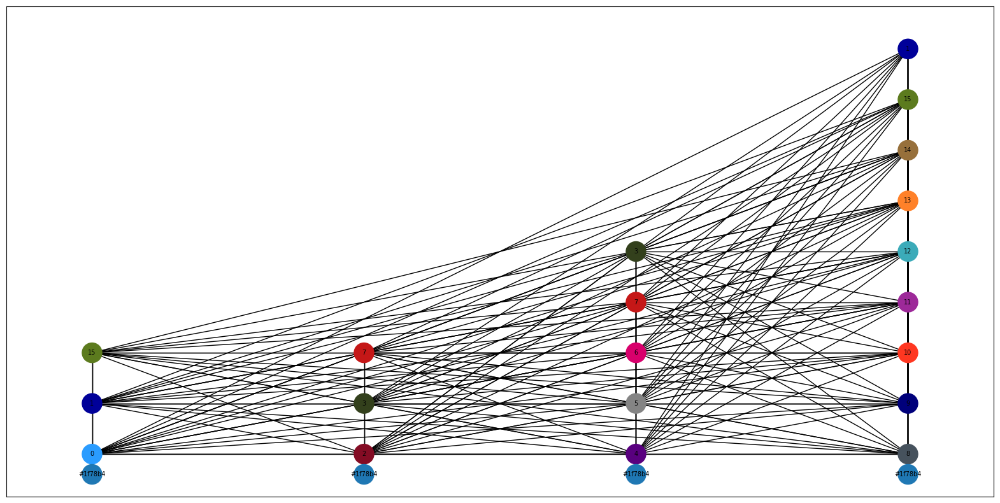

(16, 32)


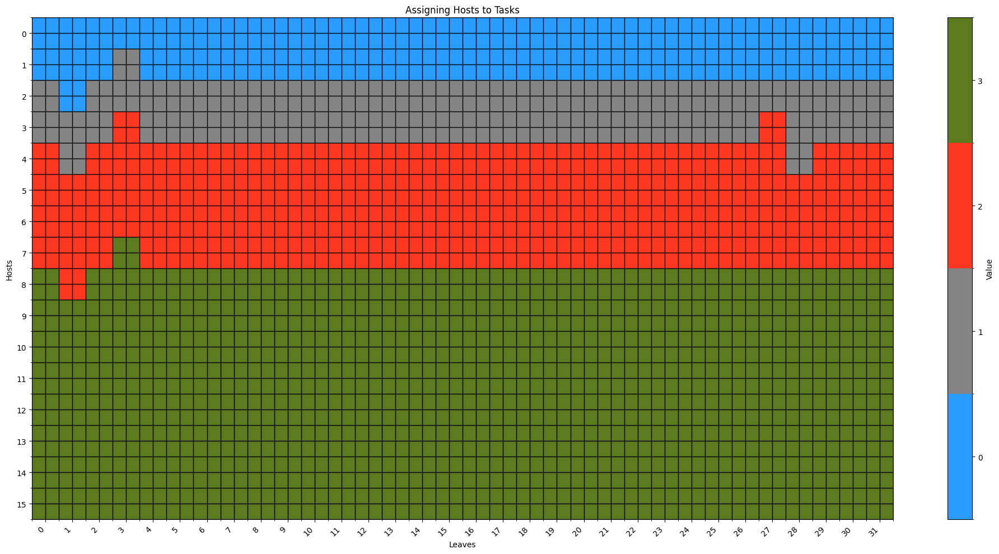

5 32 16


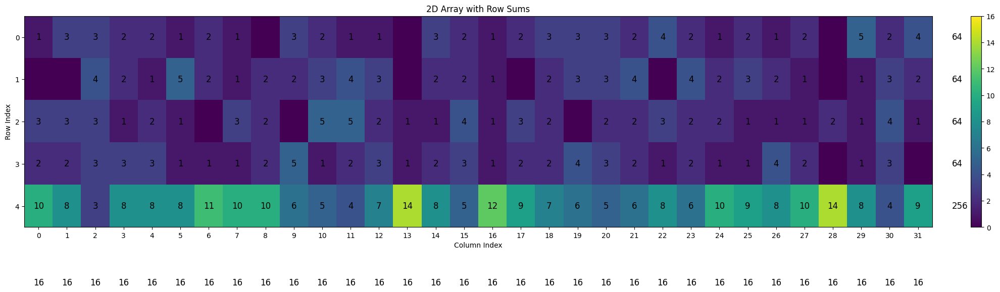

greedy_colors 21
nodes 34 density 0.7593582887700535


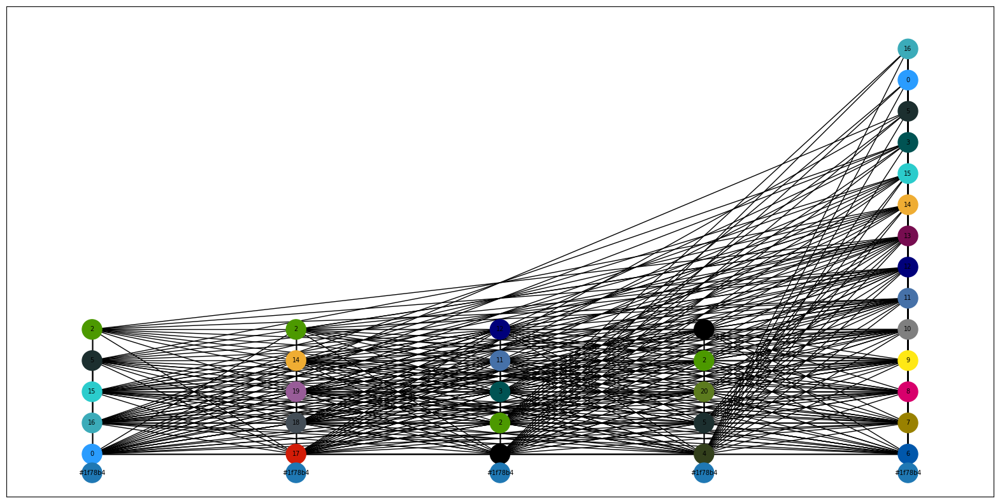



-----------------


finished in 103 iterations


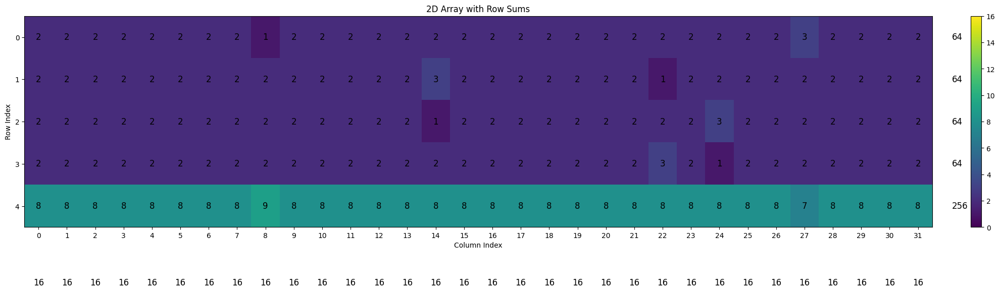

greedy_colors 16
nodes 21 density 0.9285714285714286


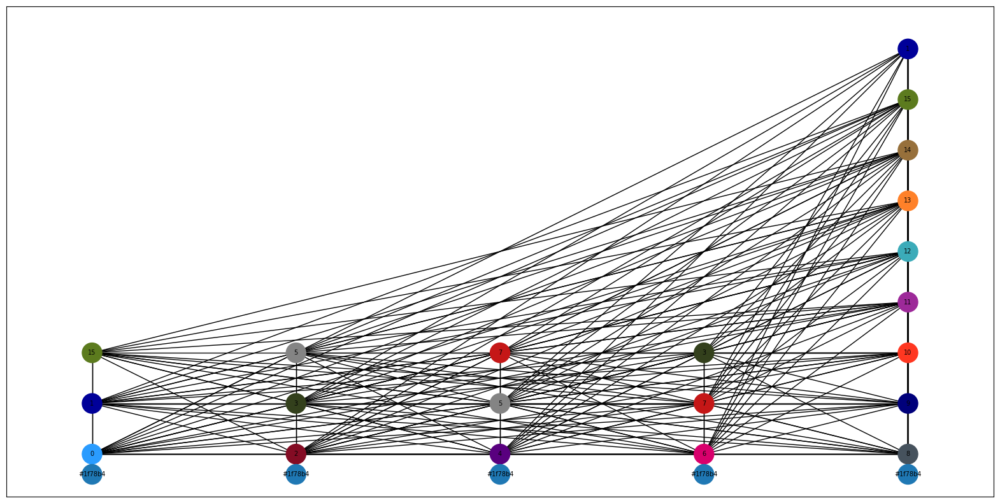

(16, 32)


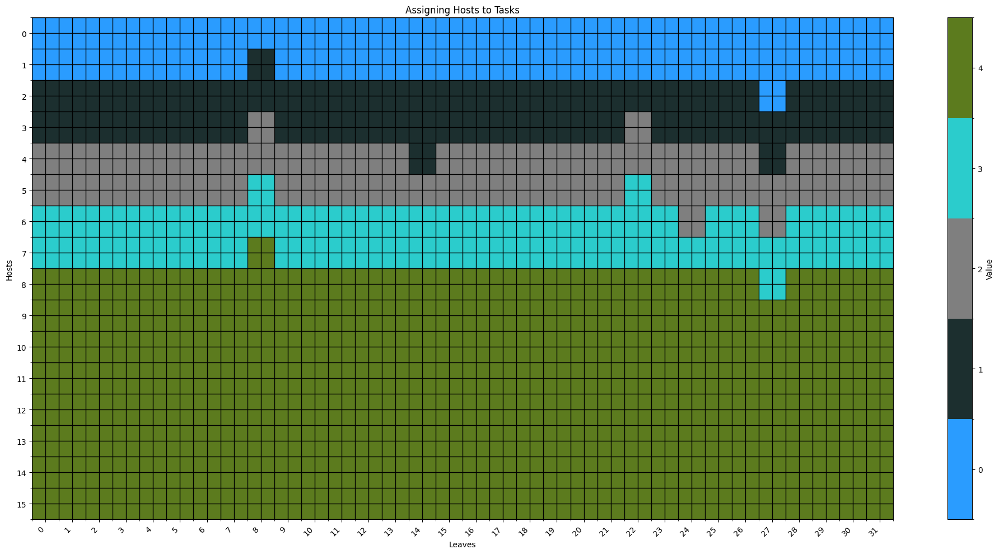

6 32 16


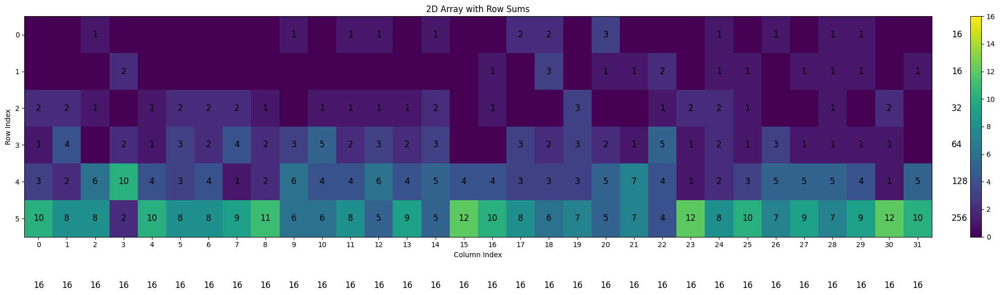

greedy_colors 21
nodes 36 density 0.7333333333333333


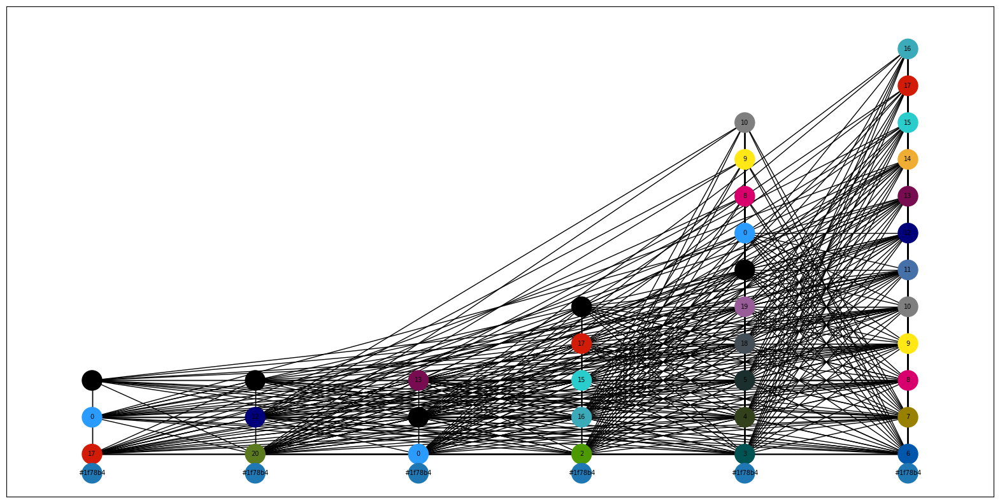



-----------------


finished in 165 iterations


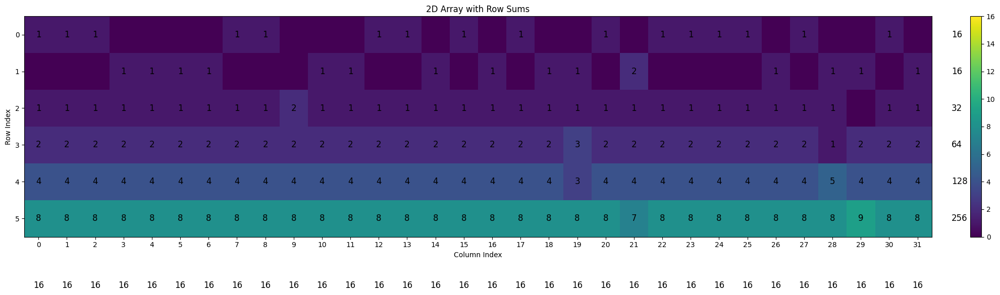

greedy_colors 16
nodes 22 density 0.9090909090909091


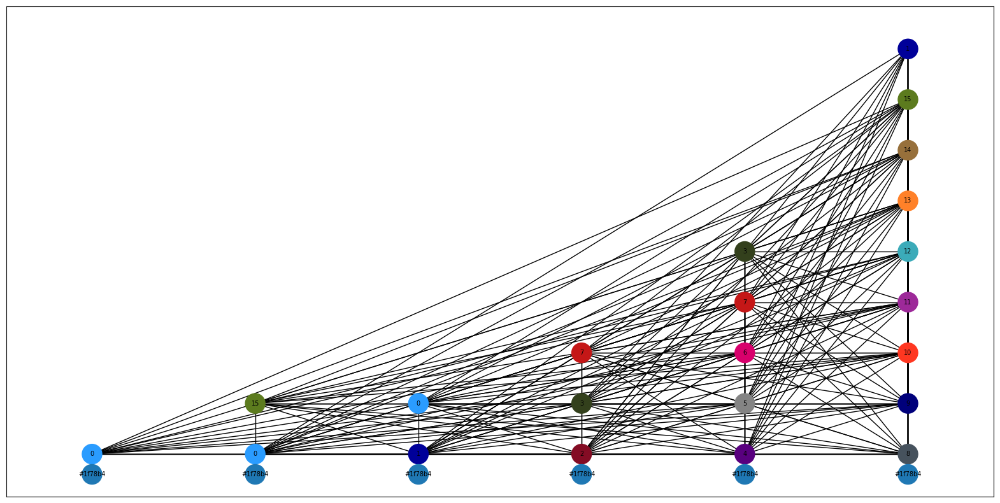

(16, 32)


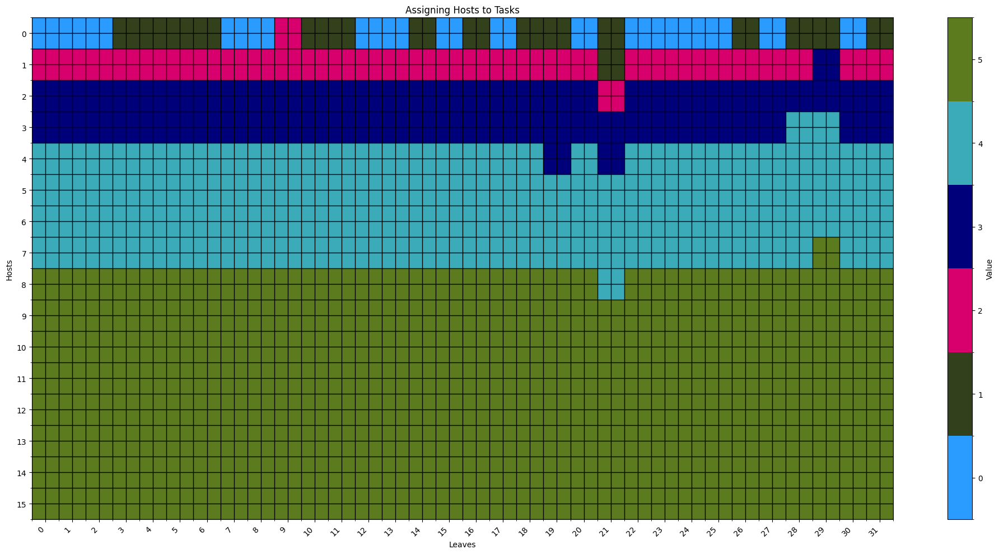

7 32 16


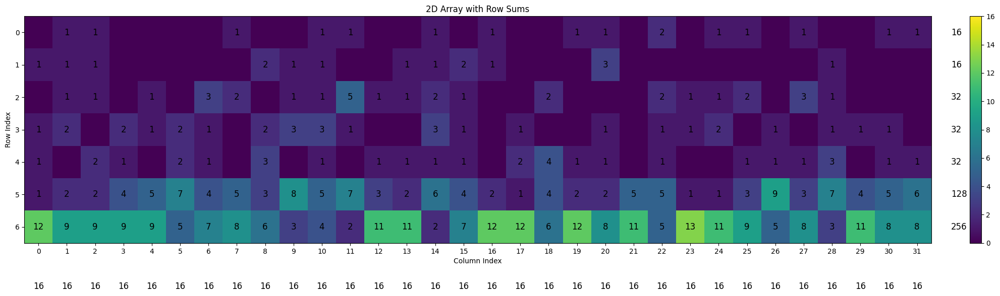

greedy_colors 23
nodes 39 density 0.7192982456140351


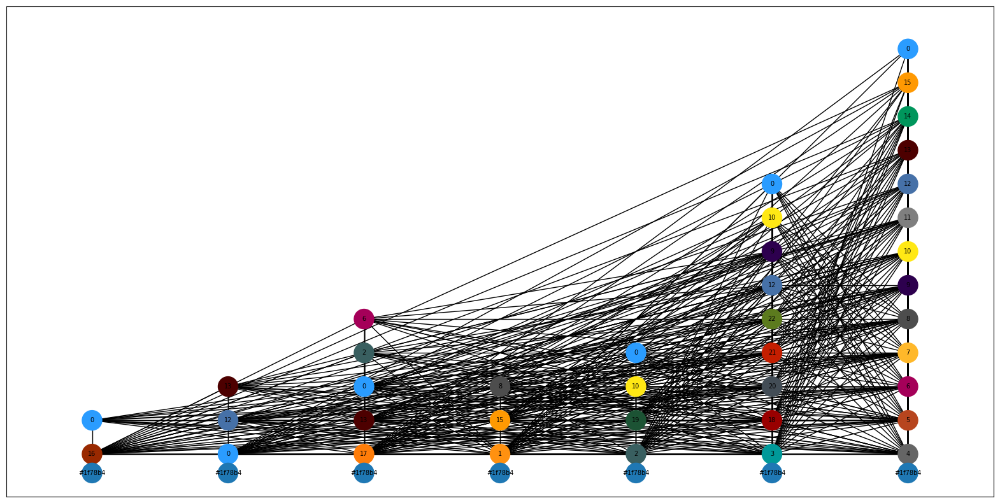



-----------------


finished in 444 iterations


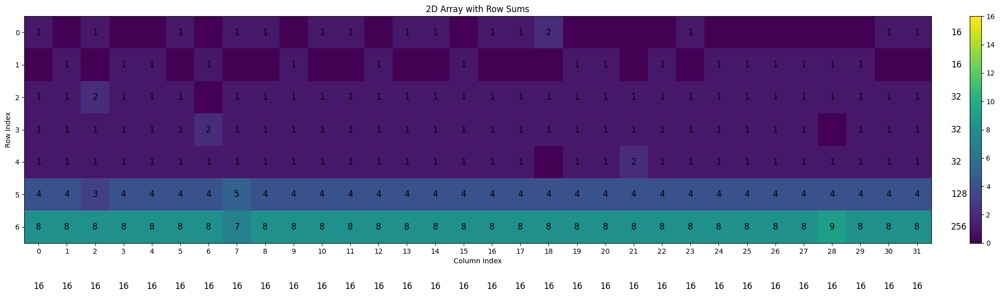

greedy_colors 16
nodes 23 density 0.8893280632411067


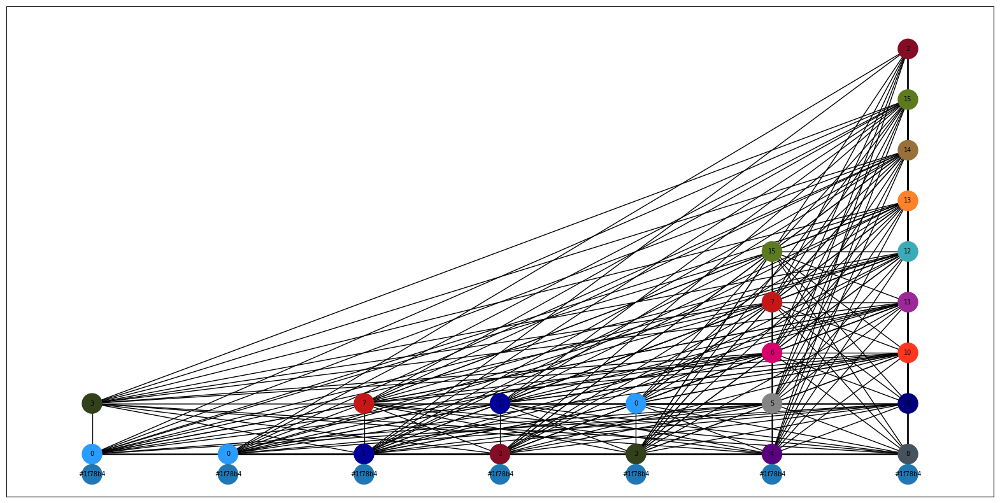

(16, 32)


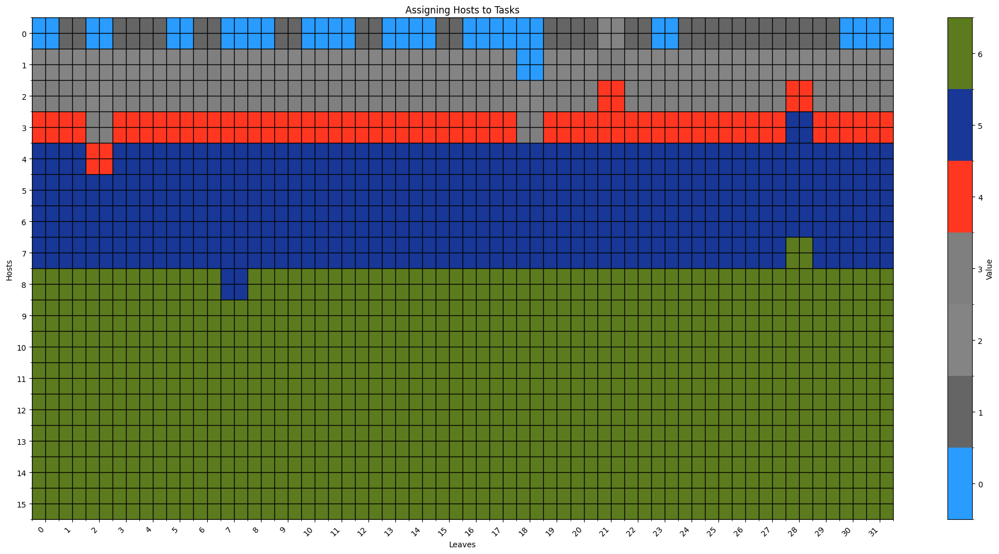

8 32 16


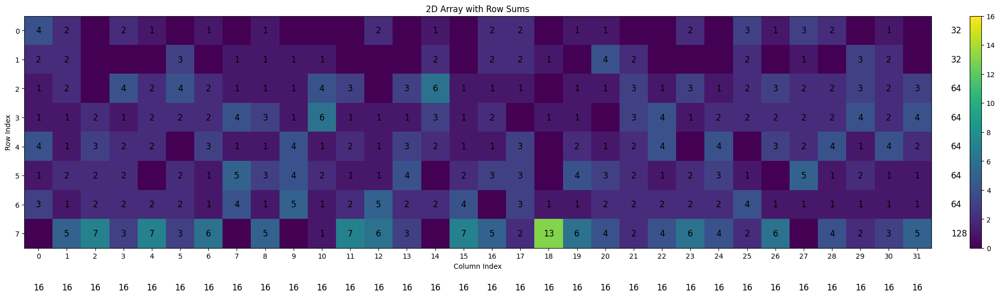

greedy_colors 25
nodes 47 density 0.633672525439408


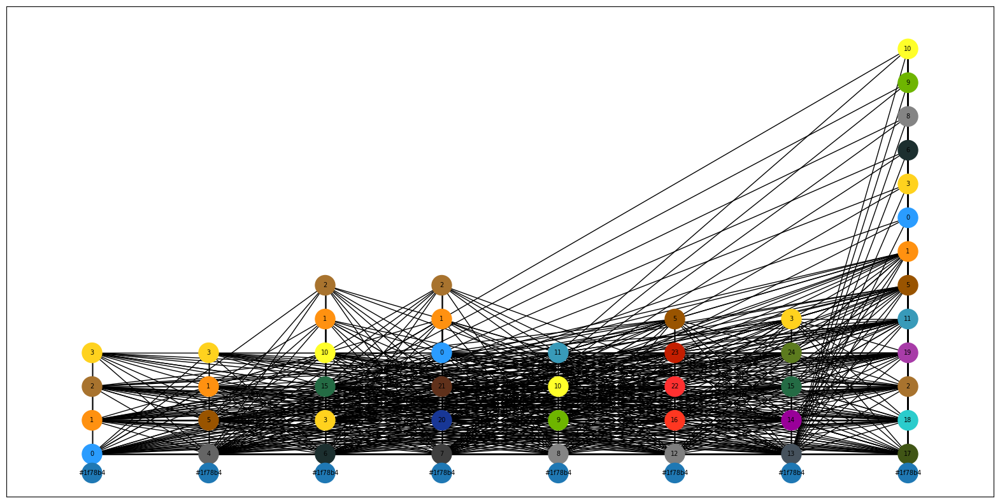



-----------------


finished in 295 iterations


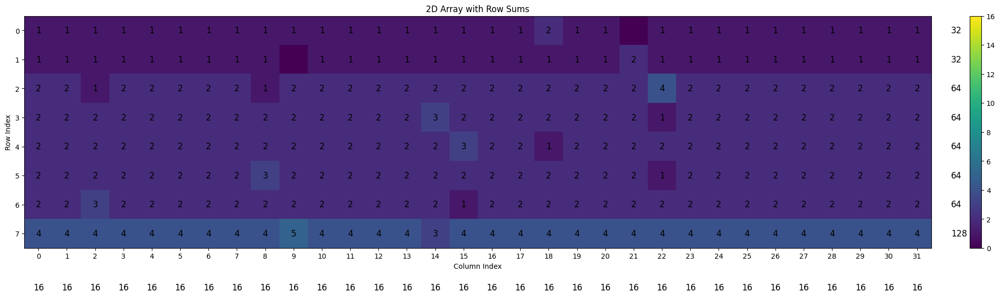

greedy_colors 16
nodes 25 density 0.8466666666666667


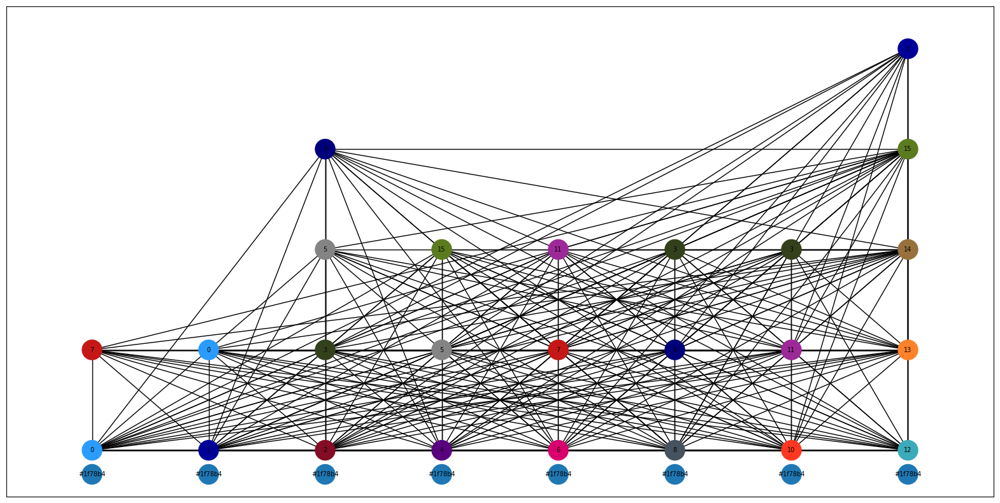

(16, 32)


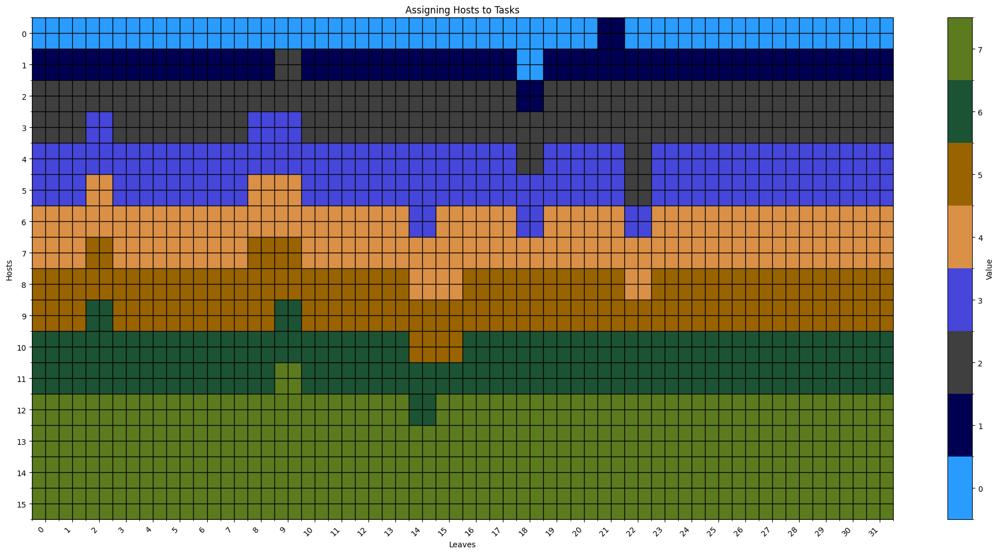

9 32 16


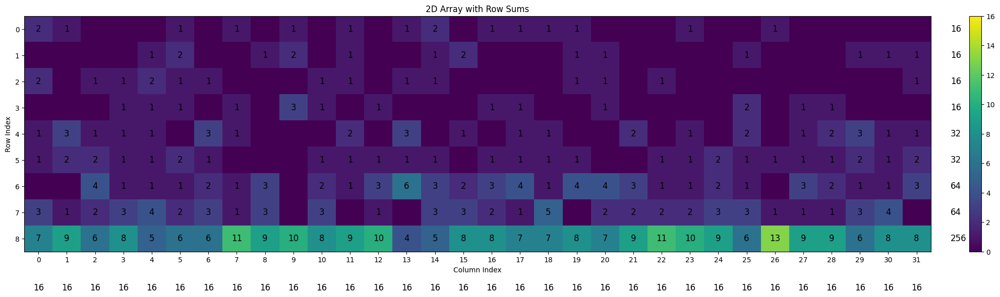

greedy_colors 24
nodes 38 density 0.7411095305832148


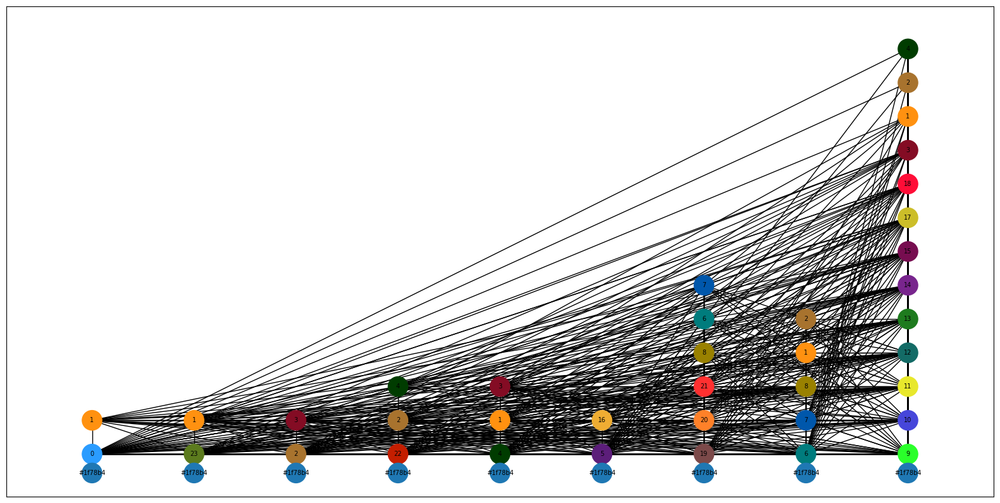



-----------------




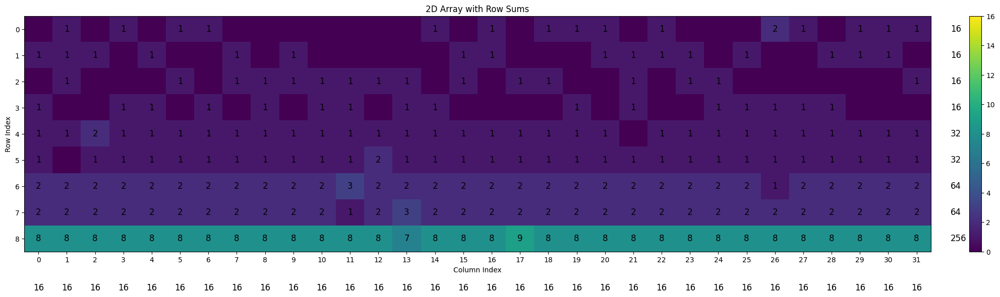

greedy_colors 18
nodes 24 density 0.8804347826086957


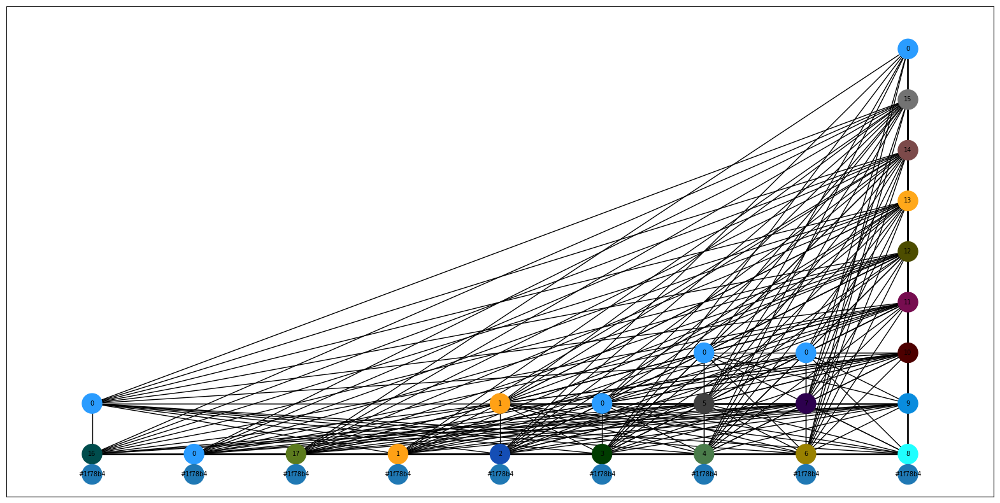

10 32 16


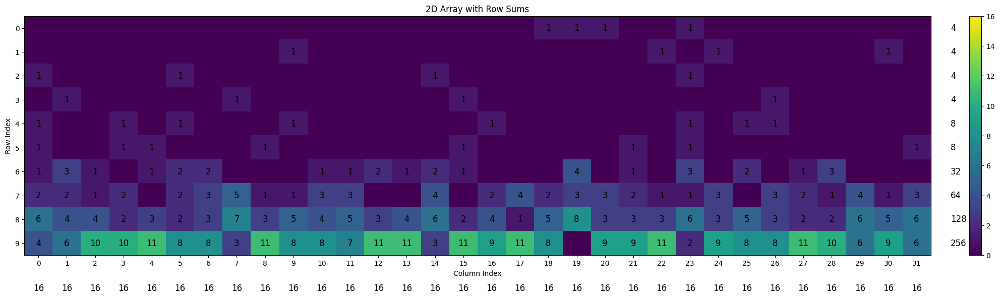

greedy_colors 24
nodes 34 density 0.8342245989304813


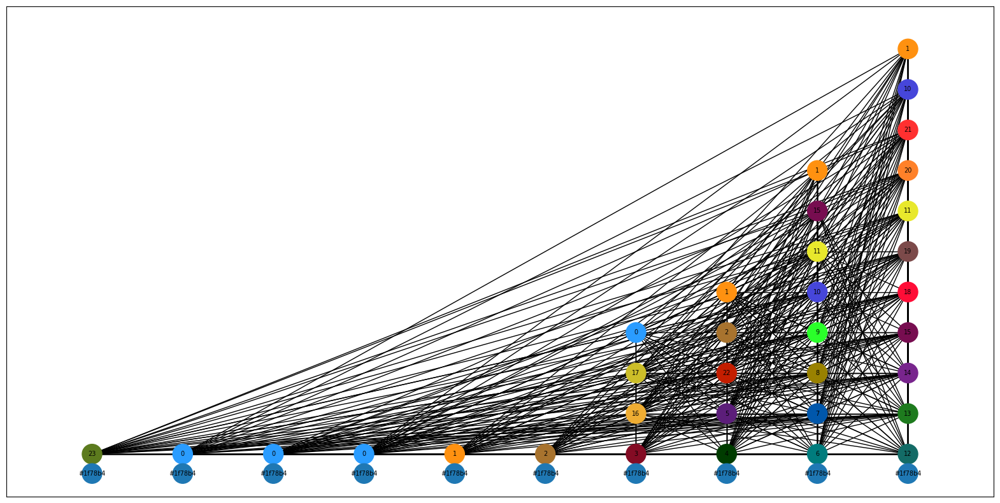



-----------------


finished in 1283 iterations


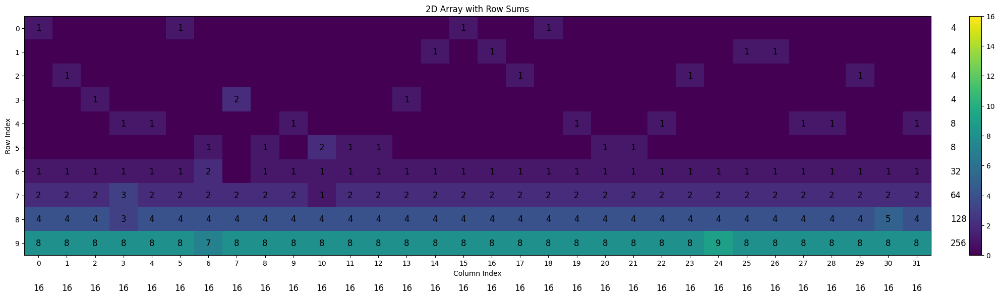

greedy_colors 16
nodes 27 density 0.811965811965812


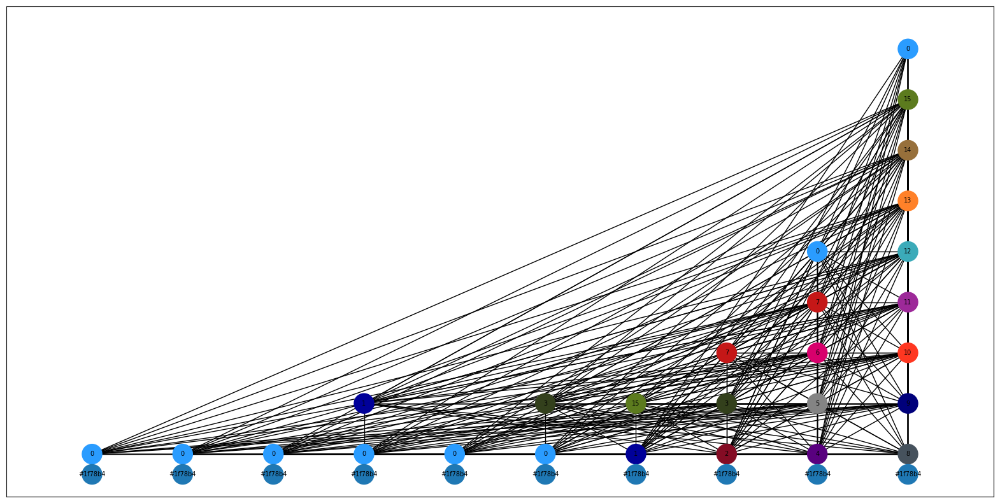

(16, 32)


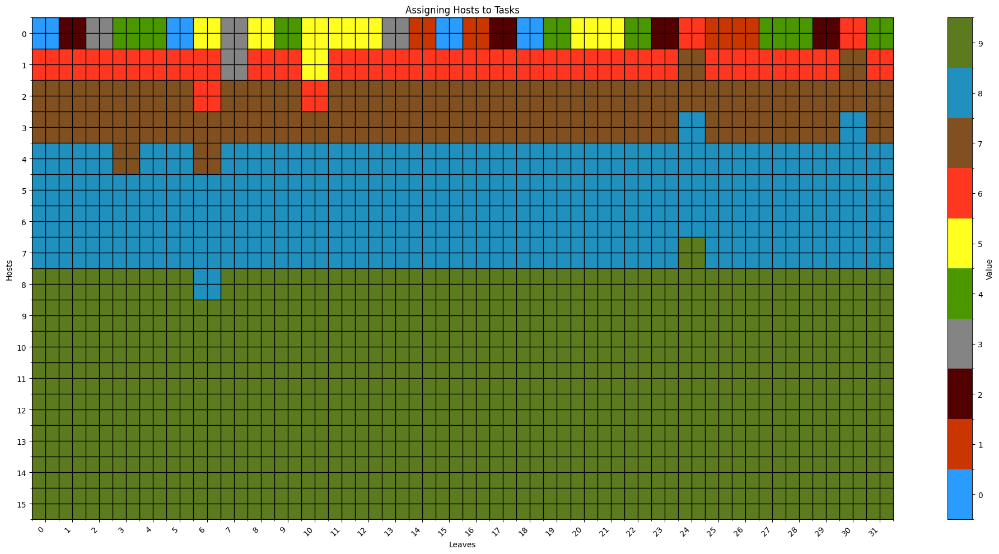

In [117]:
l, s = 32, 16
alpha = 0.0
for t in [2,3,4,5,6,7,8,9,10]:
    print(t,l,s)
    task_distributions = f(t, s*l)
    pos = np.random.choice(list(range(len(task_distributions))))
    task_distribution = task_distributions[pos]
    
    ranking_dense, coloring = make_test(t,l,s,task_distribution,alpha, get_neighbor_ranking_sily)
    # assignment_board(t, l, s, ranking_dense)

8 64 32


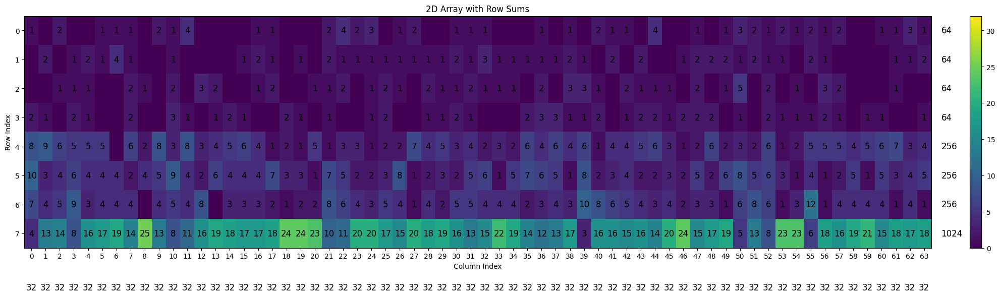

greedy_colors 46
nodes 72 density 0.7875586854460094


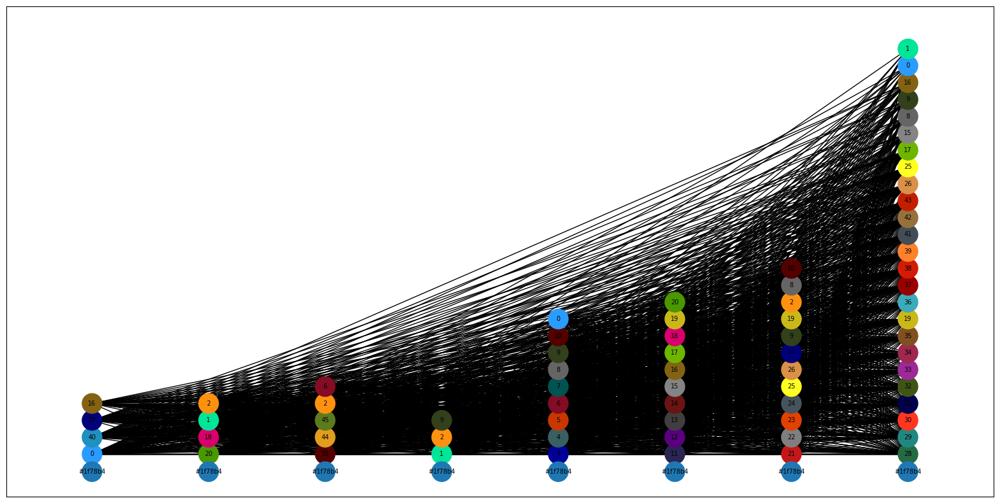



-----------------


finished in 2465 iterations


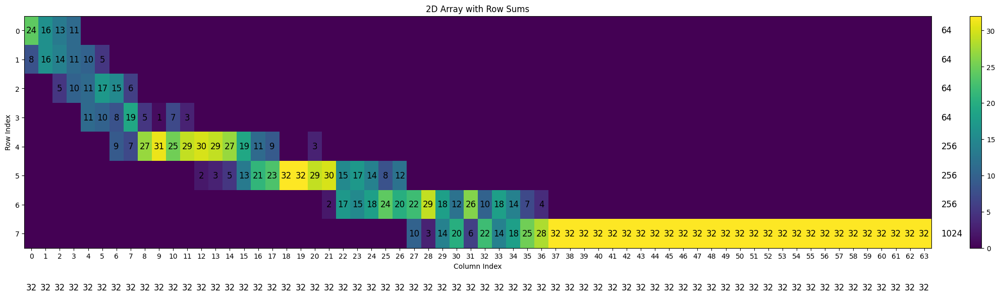

greedy_colors 32
nodes 200 density 0.26040201005025126


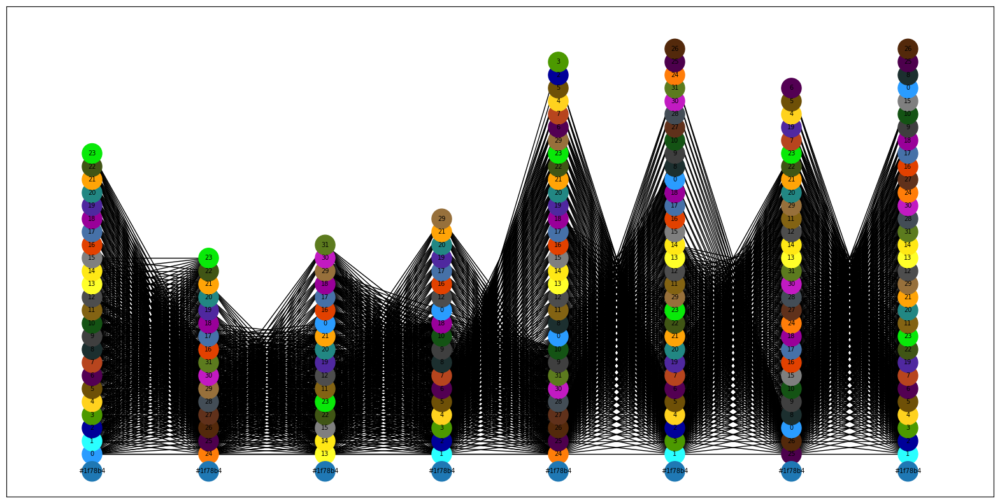

(32, 64)


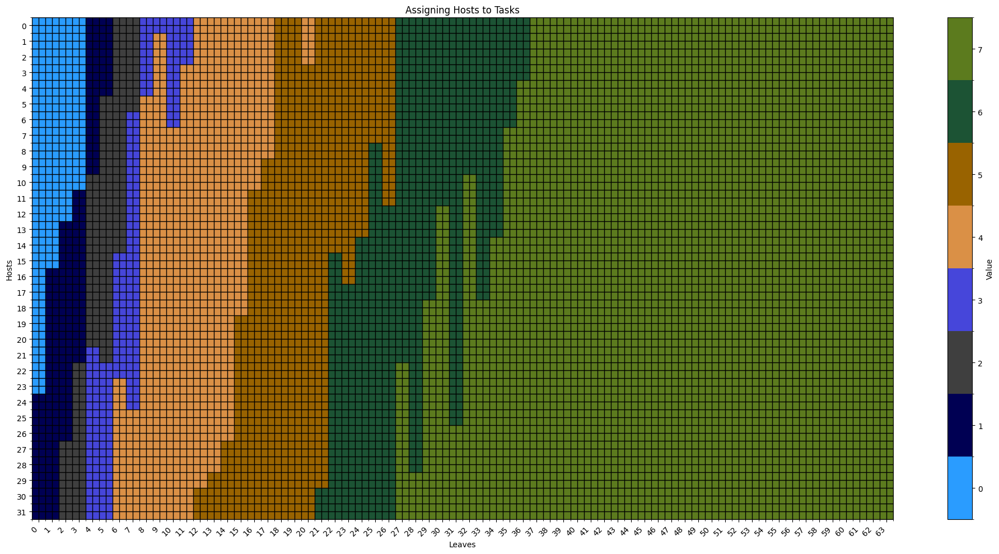

9 64 32


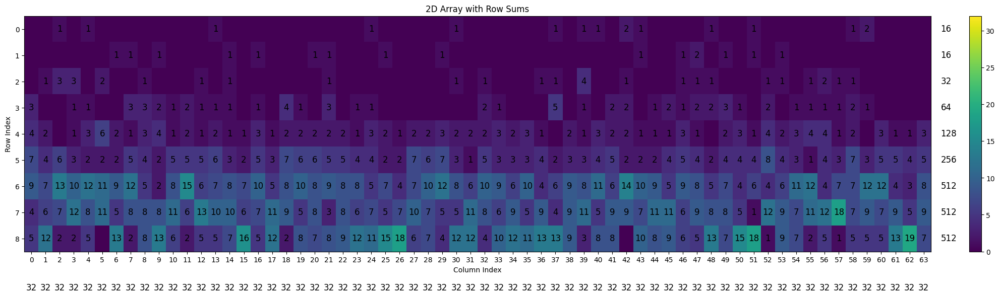

greedy_colors 45
nodes 79 density 0.7224926971762414


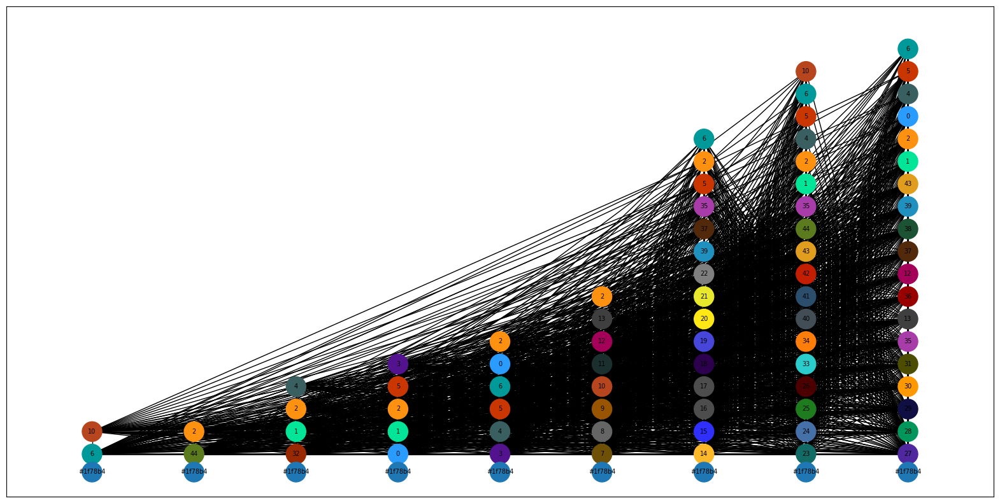



-----------------


finished in 2438 iterations


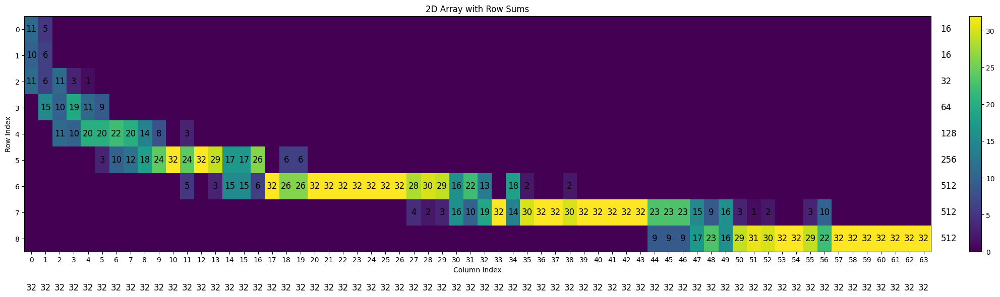

greedy_colors 32
nodes 201 density 0.26243781094527363


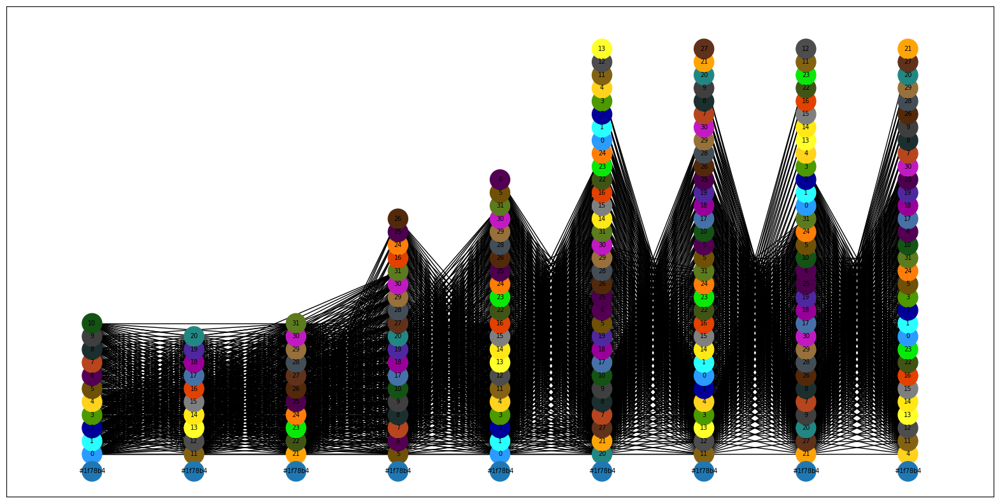

(32, 64)


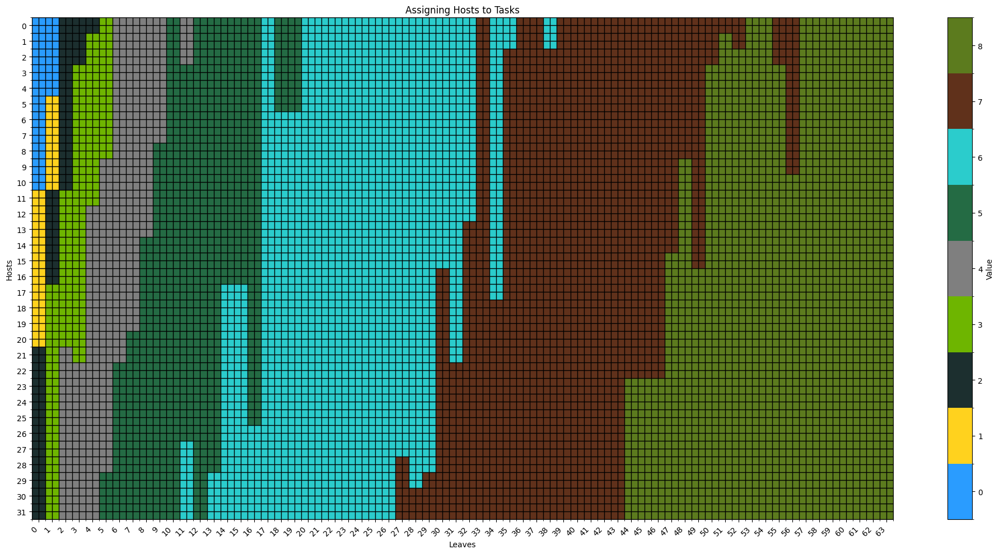

10 64 32


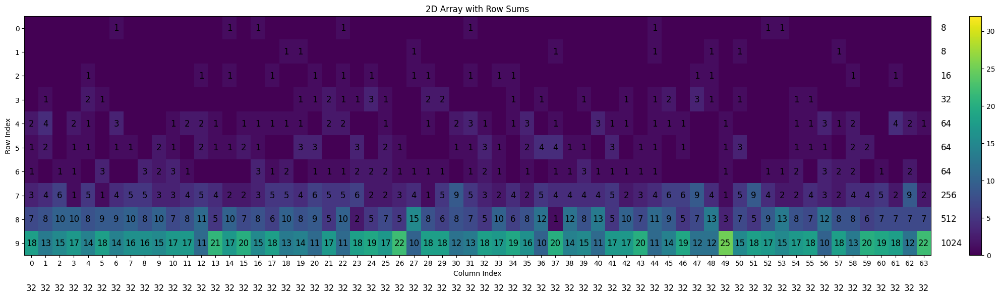

greedy_colors 43
nodes 66 density 0.8256410256410256


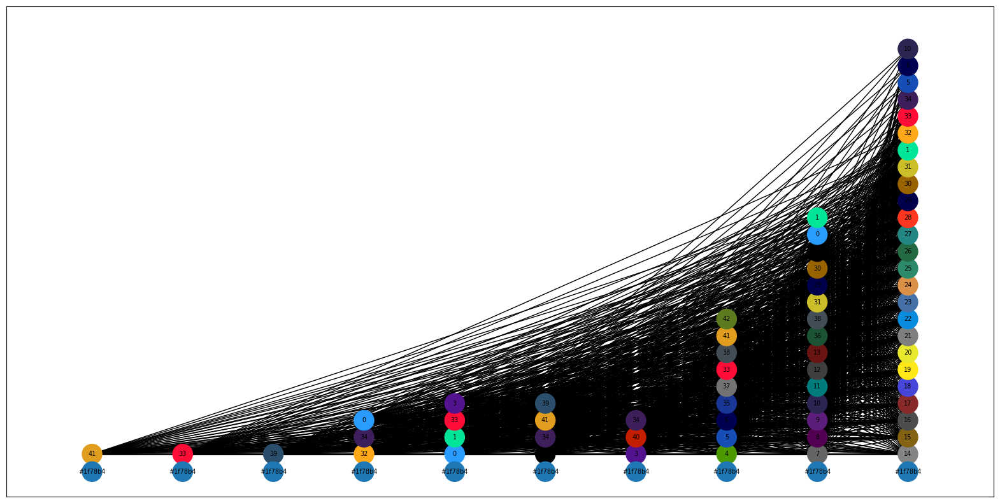



-----------------


finished in 2173 iterations


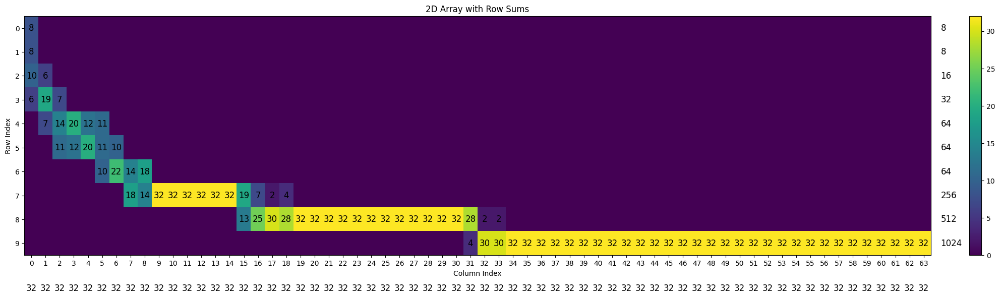

greedy_colors 32
nodes 203 density 0.2255767448666049


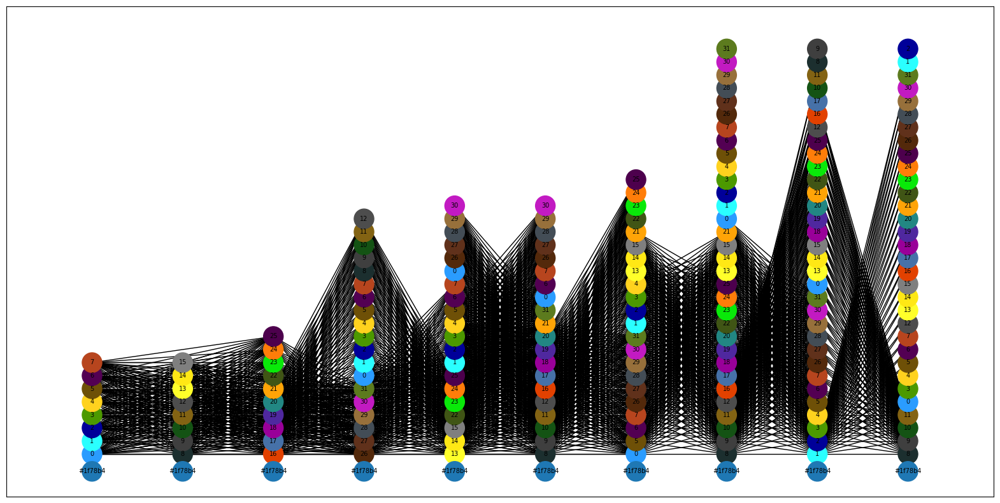

(32, 64)


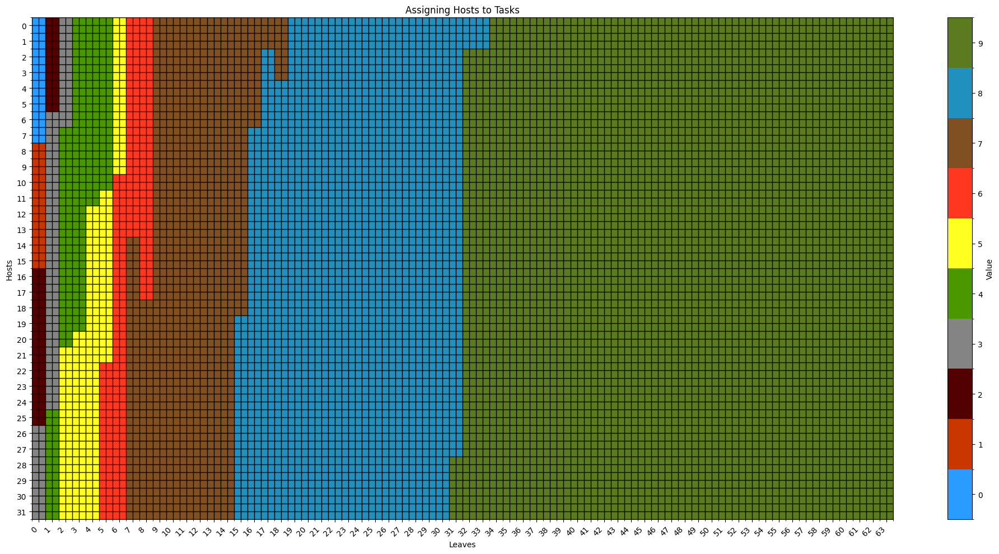

11 64 32


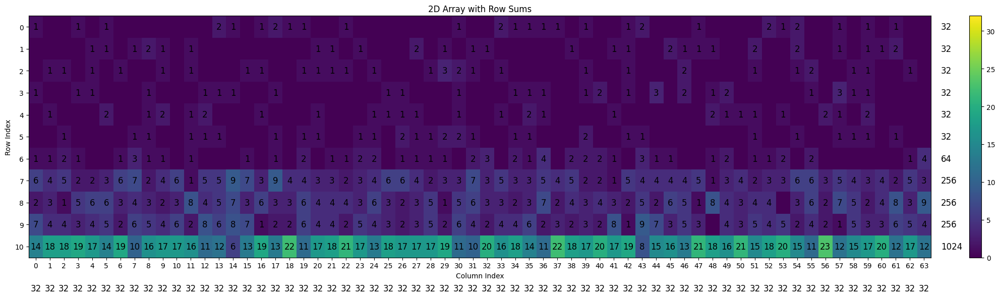

greedy_colors 46
nodes 68 density 0.8446005267778753


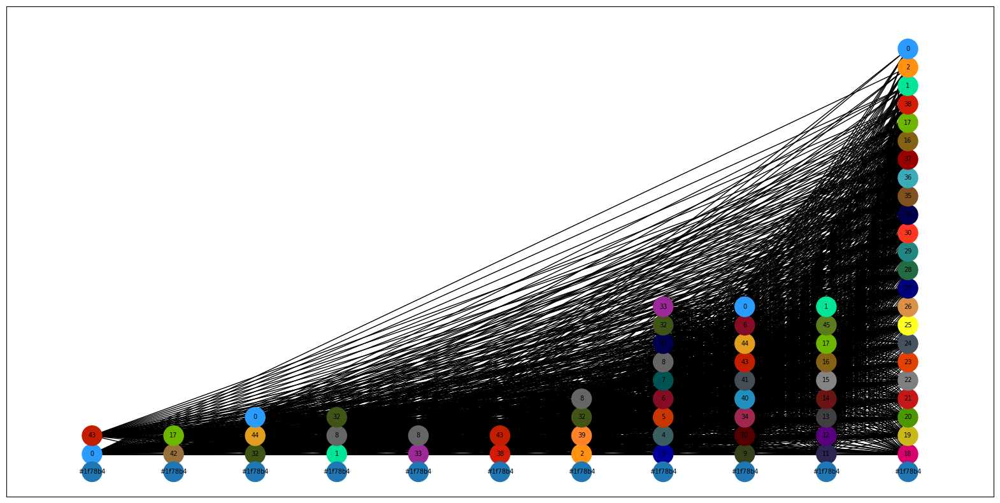



-----------------


finished in 2613 iterations


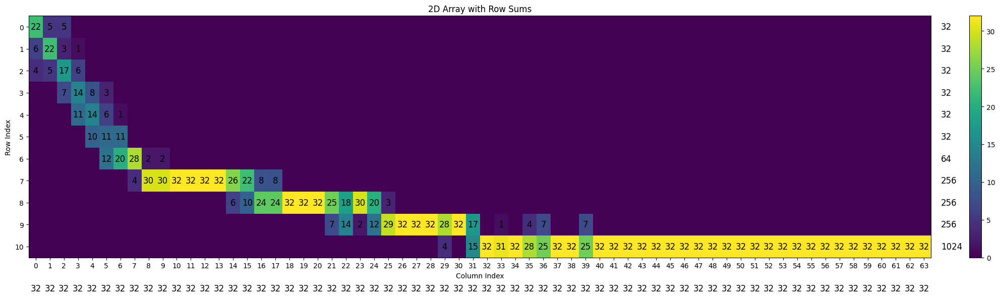

greedy_colors 32
nodes 256 density 0.18449754901960785


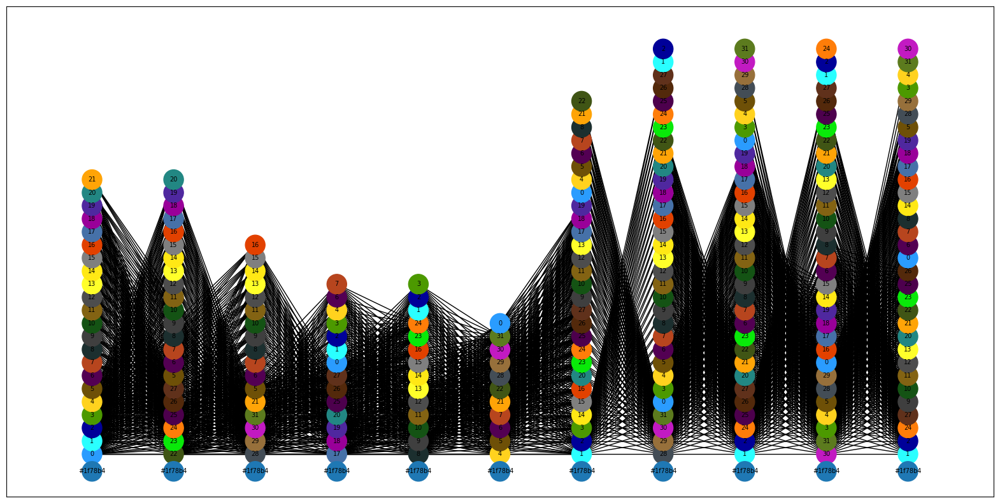

(32, 64)


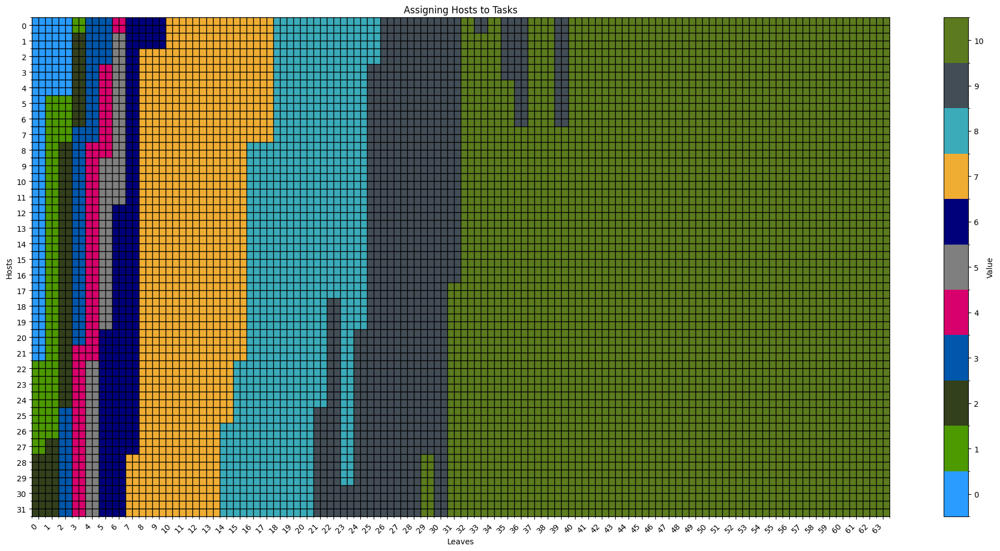

13 64 32


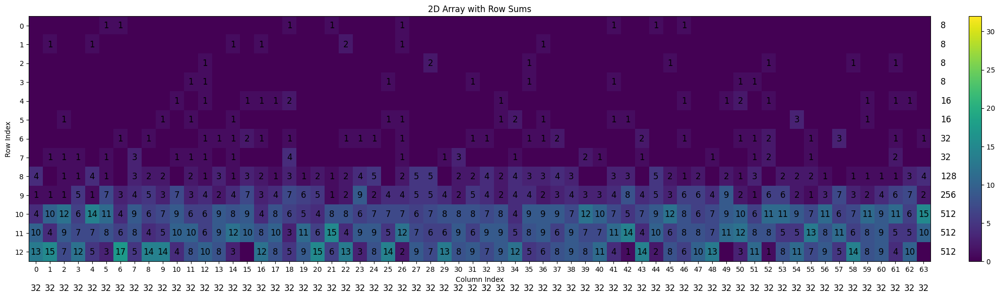

greedy_colors 46
nodes 79 density 0.7565725413826679


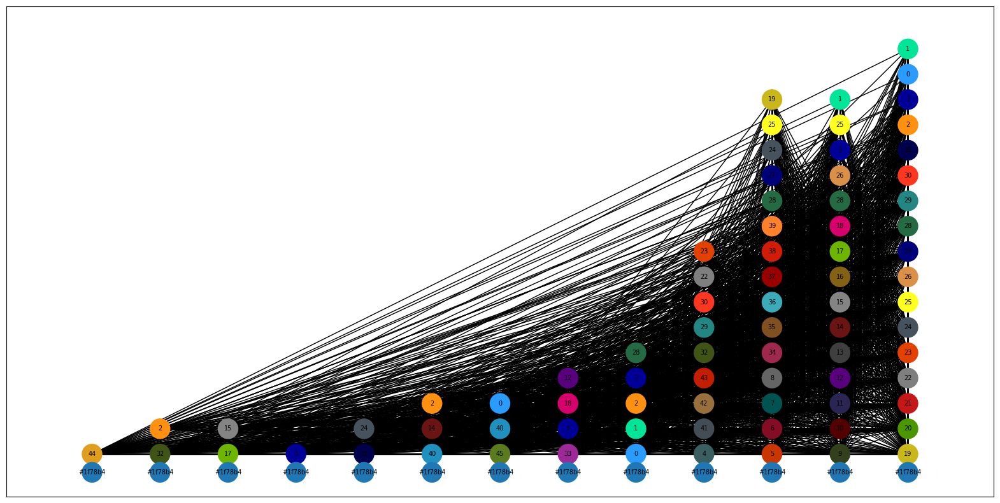



-----------------


finished in 2587 iterations


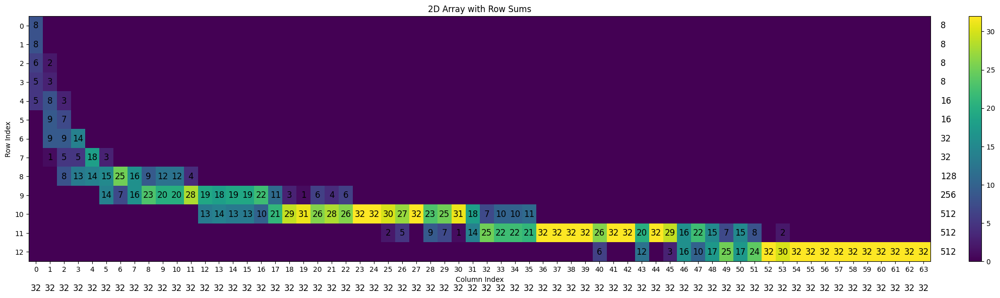

greedy_colors 32
nodes 225 density 0.22583333333333333


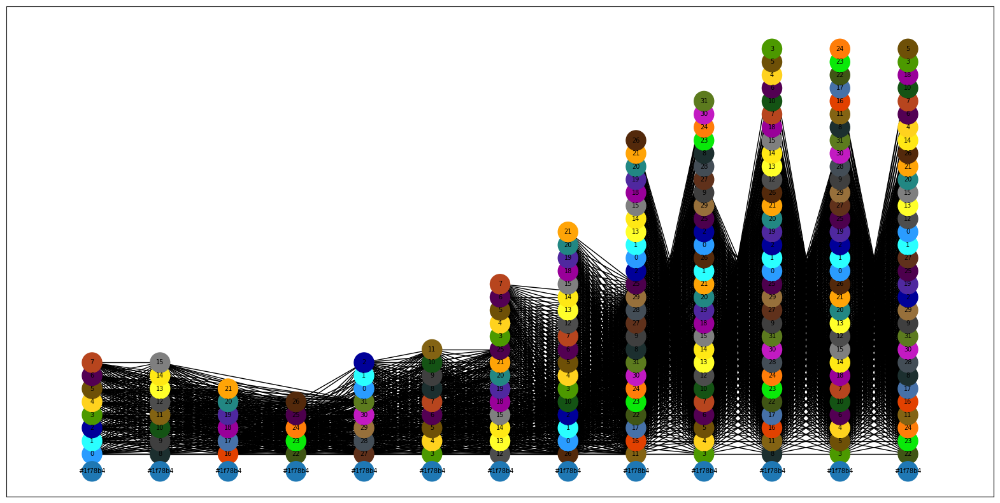

(32, 64)


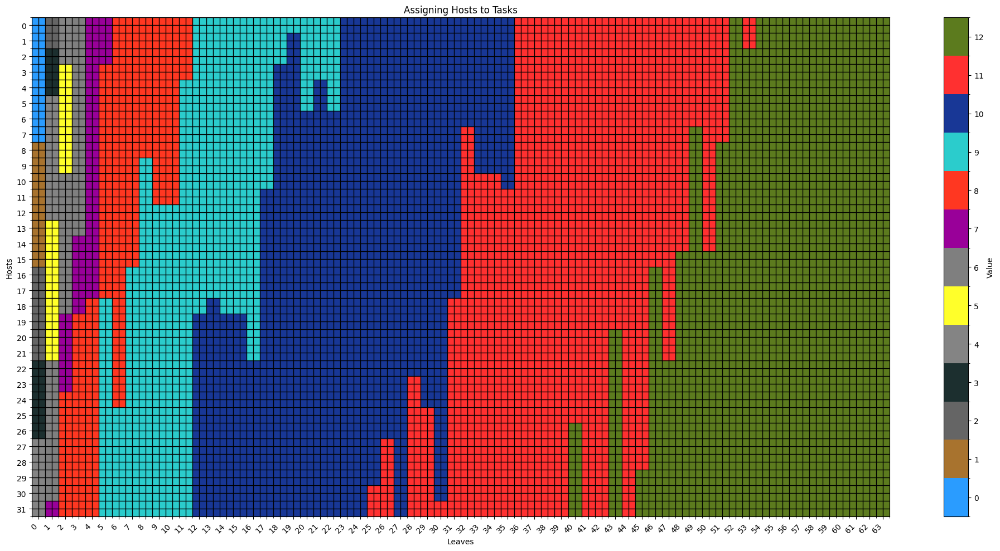

14 64 32


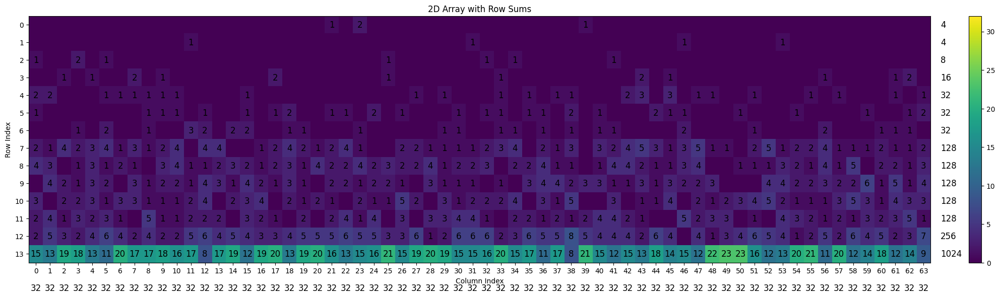

greedy_colors 47
nodes 72 density 0.809076682316119


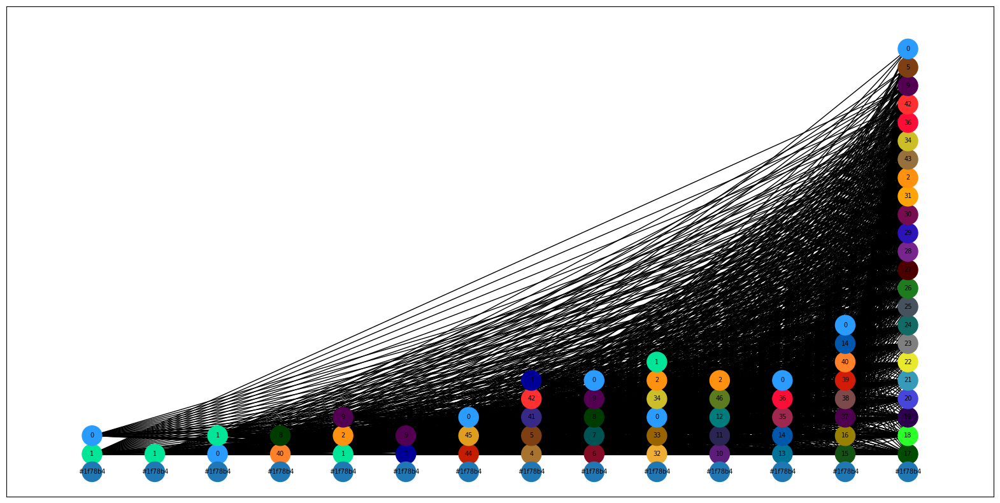



-----------------


finished in 2945 iterations


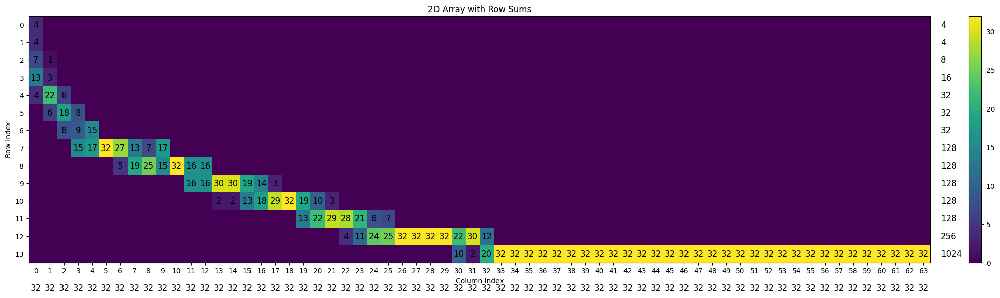

greedy_colors 32
nodes 302 density 0.1603045037512926


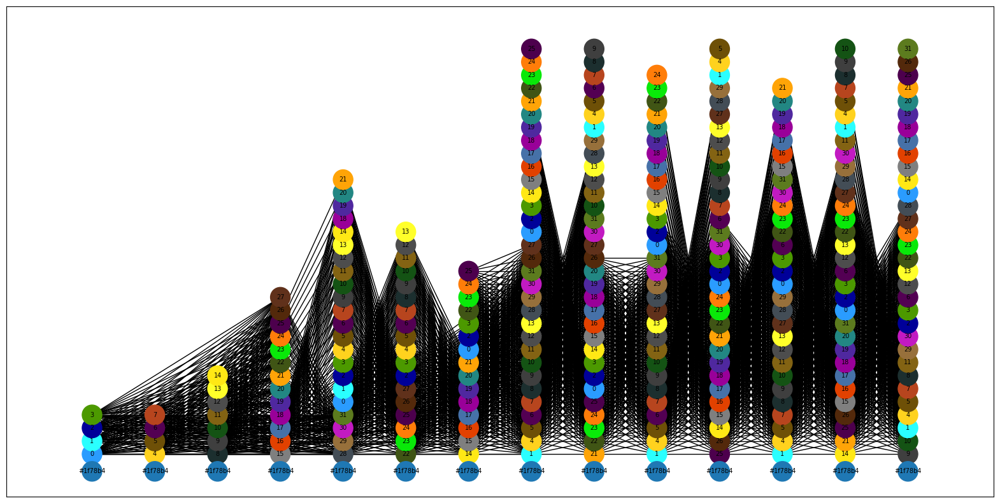

(32, 64)


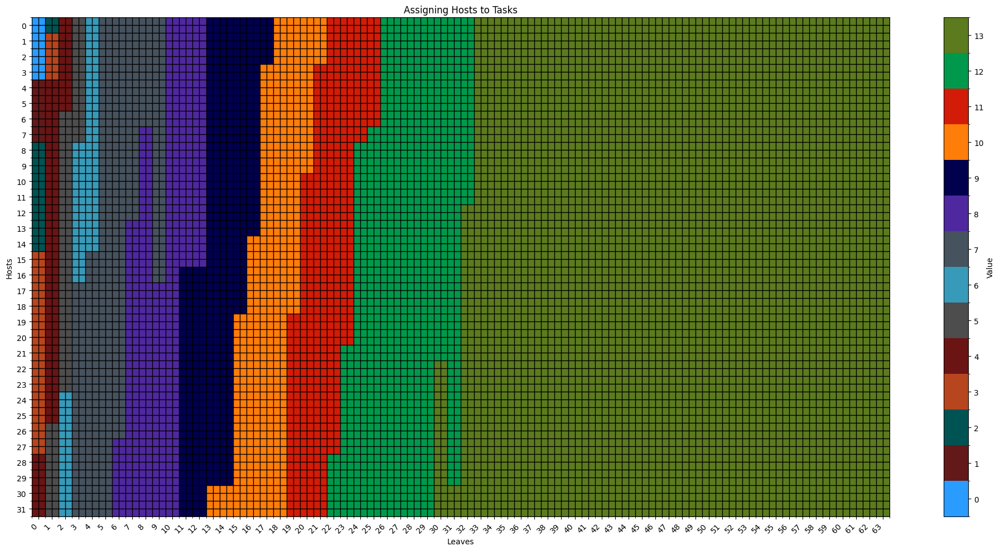

15 64 32


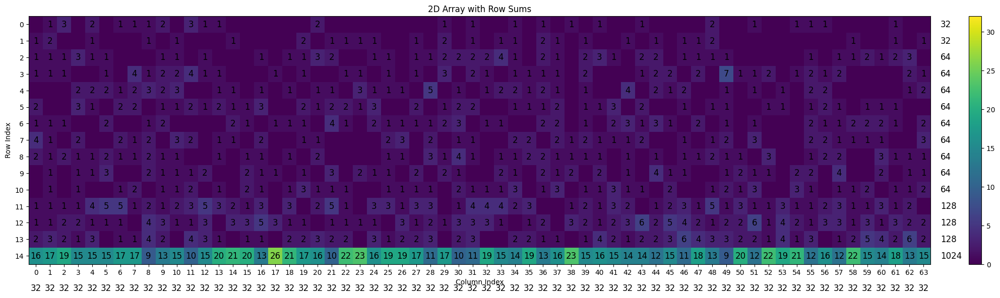

greedy_colors 49
nodes 86 density 0.7285909712722298


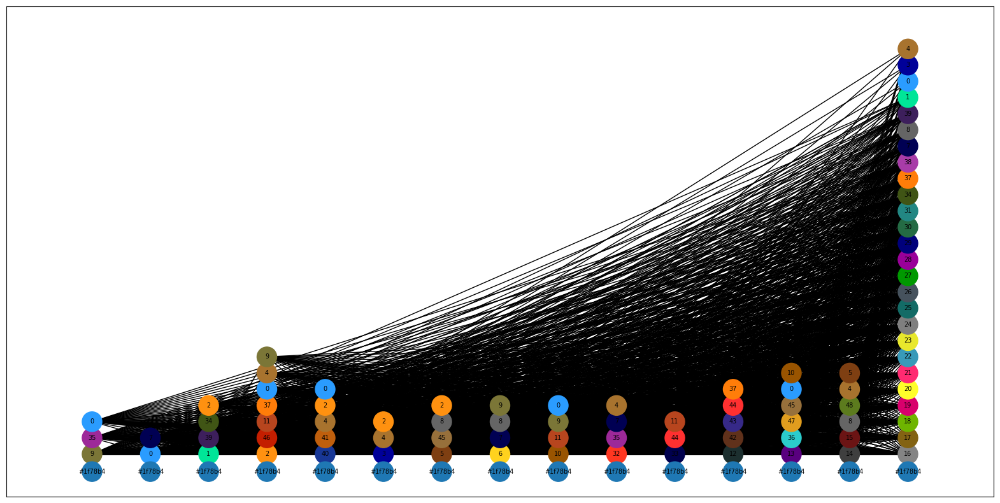



-----------------


finished in 3667 iterations


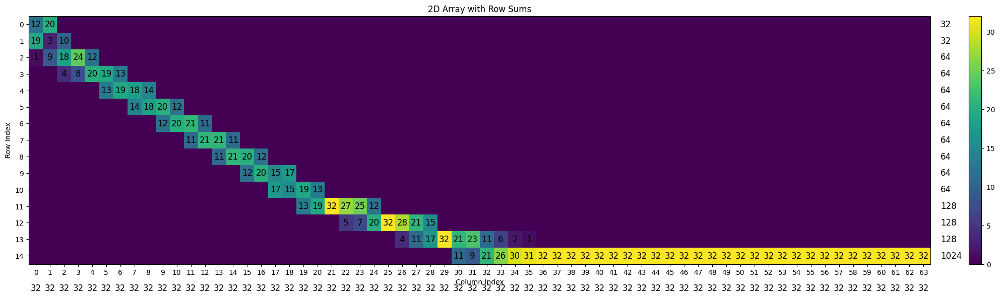

greedy_colors 32
nodes 352 density 0.1431785806785807


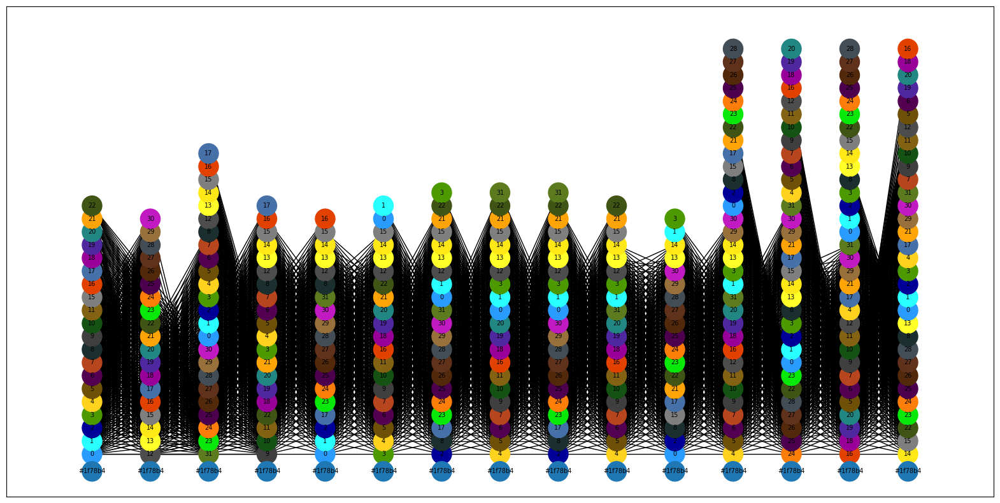

(32, 64)


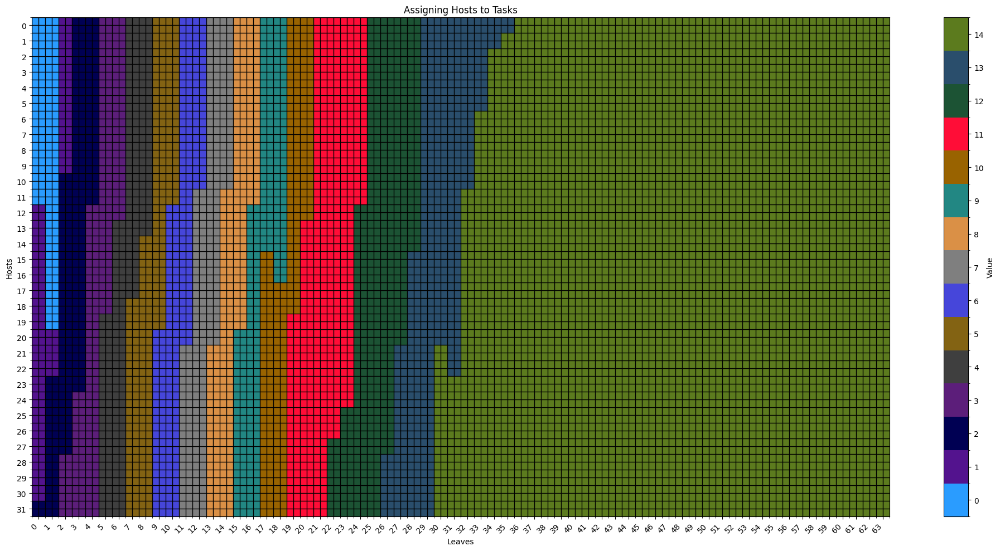

In [118]:
l, s = 64, 32
alpha = 0.0
for t in [8,9,10, 11, 13, 14, 15]:
    print(t,l,s)
    task_distributions = f(t, s*l)
    pos = np.random.choice(list(range(len(task_distributions))))
    task_distribution = task_distributions[pos]
    
    ranking_dense, coloring = make_test(t,l,s,task_distribution,alpha, get_neighbor_ranking)

In [40]:
G = get_ranking_graph(t, l, s, ranking_dense)
for u, v in G.edges:
    if coloring[u] == coloring[v]:
        print(u,v)

In [41]:
ranking_dense

array([[0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0],
       [0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1],
       [1, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0],
       [0, 1, 0, 0, 0, 0, 0, 1, 0, 2, 0, 0, 0, 0, 0, 0],
       [0, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1],
       [3, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2],
       [4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 4, 5, 5, 4, 4, 4]])

In [112]:
arr = f(12, 2048)
print([x for x in arr if x[0] >= 8])

[[32, 32, 64, 64, 64, 64, 64, 128, 256, 256, 512, 512], [16, 16, 16, 16, 32, 32, 128, 128, 128, 256, 256, 1024], [8, 8, 8, 8, 32, 64, 64, 64, 256, 256, 256, 1024], [16, 16, 32, 64, 128, 128, 128, 256, 256, 256, 256, 512], [16, 16, 16, 16, 16, 16, 32, 128, 256, 512, 512, 512], [8, 8, 16, 32, 32, 32, 64, 64, 128, 128, 512, 1024], [16, 16, 16, 16, 16, 16, 16, 16, 128, 256, 512, 1024], [16, 16, 32, 64, 128, 128, 128, 128, 128, 128, 128, 1024], [32, 32, 32, 32, 128, 128, 128, 128, 128, 128, 128, 1024], [8, 8, 16, 32, 32, 32, 128, 256, 256, 256, 512, 512], [8, 8, 8, 8, 16, 16, 32, 32, 128, 256, 512, 1024], [64, 64, 64, 64, 64, 64, 128, 256, 256, 256, 256, 512], [16, 16, 16, 16, 64, 64, 64, 64, 64, 128, 512, 1024], [16, 16, 32, 64, 64, 64, 64, 64, 64, 64, 512, 1024], [64, 64, 64, 64, 128, 128, 128, 128, 256, 256, 256, 512], [8, 8, 16, 32, 64, 64, 64, 64, 64, 128, 512, 1024], [8, 8, 16, 16, 16, 64, 64, 64, 128, 128, 512, 1024], [32, 32, 32, 32, 32, 32, 32, 32, 128, 128, 512, 1024], [8, 8, 16, 

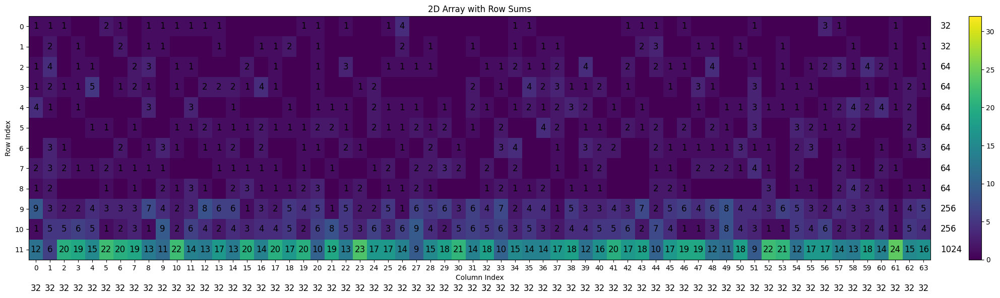

greedy_colors 49
nodes 78 density 0.7712287712287712


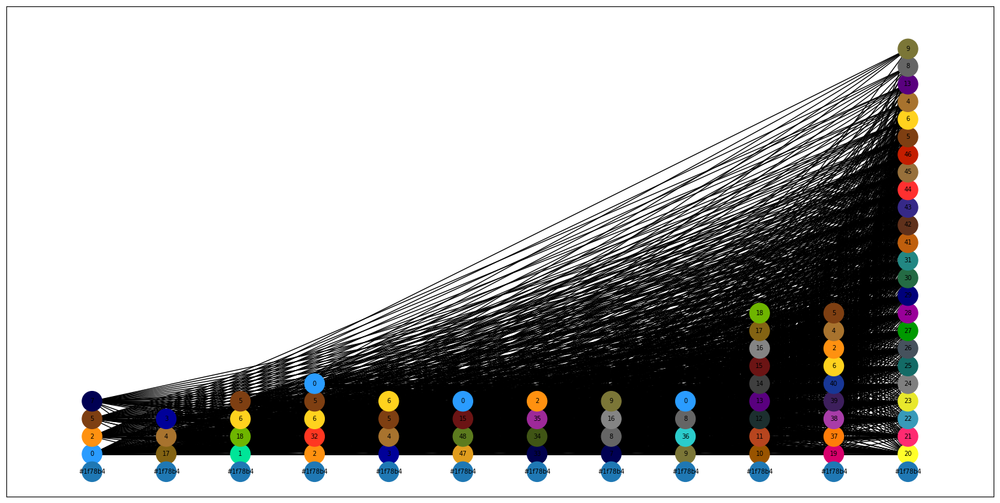



-----------------


finished in 3083 iterations


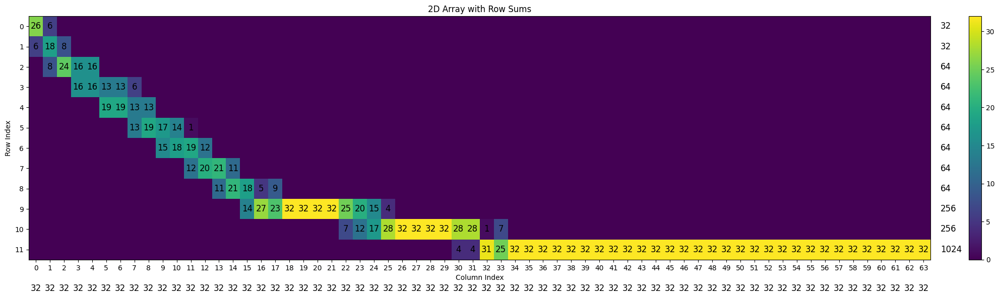

greedy_colors 32
nodes 279 density 0.17168200923132462


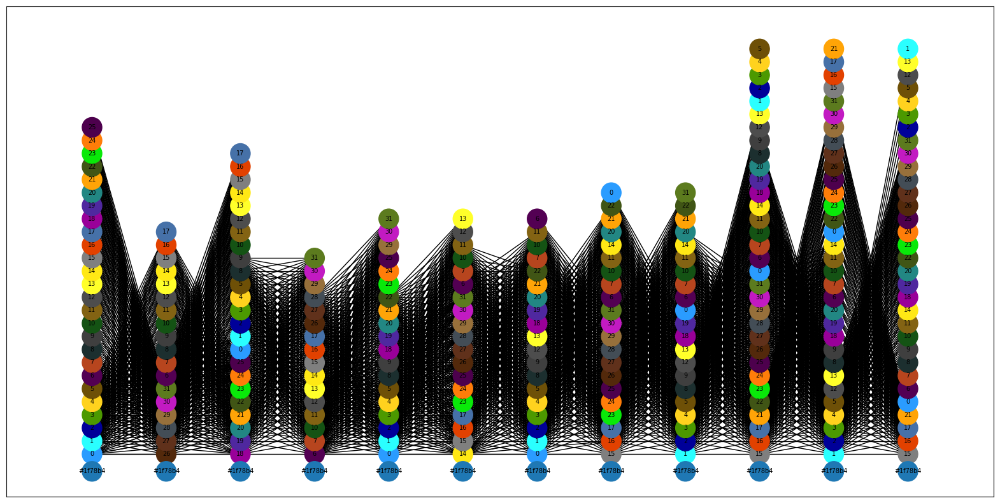

(32, 64)


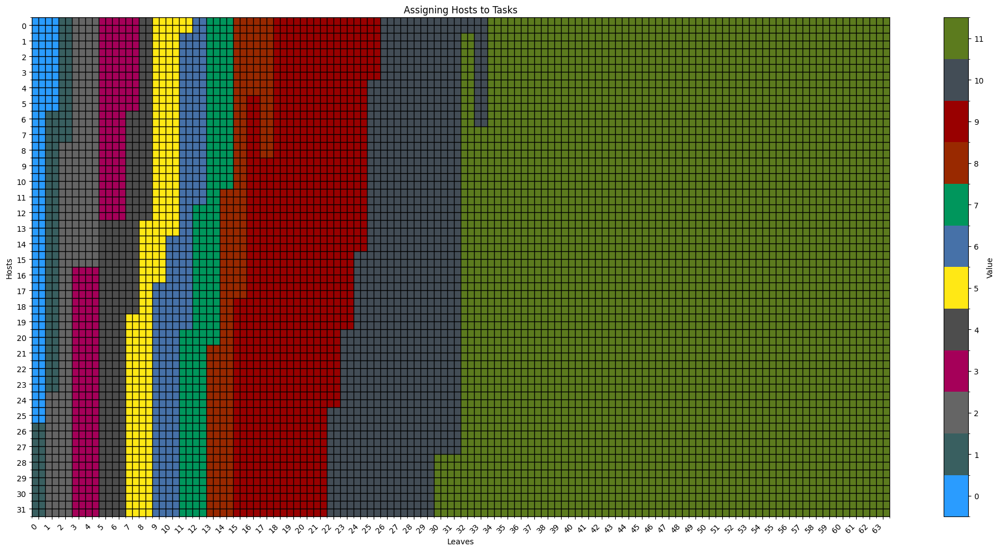



-----------------


CPU times: total: 2min 27s
Wall time: 2min 27s


In [114]:
%%time
np.random.seed(1)
t, l, s = 12, 64, 32
task_distribution = [32, 32, 64, 64, 64, 64, 64, 64, 64, 256, 256, 1024]
# t, l, s = 12, 64, 32
# task_distribution = [8, 64, 64, 64, 64, 64, 64, 64, 64, 256, 512, 512]
# t, l, s = 5, 16, 8
# task_distribution = [16, 16, 32, 32, 32]
# t, l, s = 7, 16, 8
# task_distribution = [4, 4, 4, 4, 16, 32, 64]
# t, l, s = 12, 32, 16
# task_distribution = [4, 8, 16, 16, 16, 16, 32, 32, 32, 32, 128, 128]
res = []
alpha = 0.0

start_ranking = generate_tests_alpha(t, l, s, alpha=alpha, test_num=1, task_distribution=task_distribution)

plot_ranking(t,l,s,start_ranking)
_, _, coloring = interval_ranking_coloring(t,l,s,start_ranking)
print('greedy_colors', len(set(coloring.values())))
G = get_ranking_graph(t, l, s, start_ranking)
print('nodes', len(G.nodes), 'density', 2*len(G.edges)/(len(G.nodes)*(len(G.nodes)-1)))
plot_ranking_graph(t,l,s,G, start_ranking, figsize = (20, 10), coloring=coloring)
print('\n\n-----------------\n\n')

ranking, colors = simulated_anealling(t,l,s,start_ranking, get_neighbor_ranking, max_iter=10000)
plot_ranking(t,l,s,ranking)
_, _, coloring = interval_ranking_coloring(t,l,s,ranking)
print('greedy_colors', len(set(coloring.values())))
G = get_ranking_graph(t, l, s, ranking)
print('nodes', len(G.nodes), 'density', 2*len(G.edges)/(len(G.nodes)*(len(G.nodes)-1)))
plot_ranking_graph(t,l,s,G, ranking, figsize = (20, 10), coloring=coloring)
if len(set(coloring.values())) <= s:
    assignment_board(t, l, s, ranking)
print('\n\n-----------------\n\n')

# ranking, colors = simulated_anealling(t,l,s,start_ranking, get_neighbor_ranking_sily, max_iter=10000)
# plot_ranking(t,l,s,ranking)
# _, _, coloring = interval_ranking_coloring(t,l,s,ranking)
# print('greedy_colors', len(set(coloring.values())))
# G = get_ranking_graph(t, l, s, ranking)
# print('nodes', len(G.nodes), 'density', 2*len(G.edges)/(len(G.nodes)*(len(G.nodes)-1)))
# plot_ranking_graph(t,l,s,G, ranking, figsize = (15, 8), coloring=coloring)
# assignment_board(t, l, s, ranking)

In [46]:
print(coloring)
ranking

{'0_1': 0, '0_2': 1, '0_3': 2, '0_4': 3, '0_5': 4, '0_6': 5, '0_7': 6, '0_8': 7, '0_9': 8, '0_10': 9, '0_11': 10, '0_12': 11, '0_13': 12, '0_14': 13, '0_15': 14, '0_16': 15, '0_17': 16, '0_18': 17, '0_19': 18, '0_20': 19, '0_21': 20, '0_22': 21, '0_23': 22, '0_24': 23, '0_25': 24, '0_26': 25, '0_27': 26, '0_28': 27, '0_29': 28, '0_30': 29, '0_31': 30, '0_32': 31, '1_1': 29, '1_2': 30, '1_3': 31, '1_4': 27, '1_5': 28, '1_6': 25, '1_7': 26, '1_8': 15, '1_9': 16, '1_10': 17, '1_11': 18, '1_12': 19, '1_13': 20, '1_14': 21, '1_15': 22, '1_16': 23, '1_17': 24, '1_18': 0, '1_19': 1, '1_20': 2, '1_21': 3, '1_22': 4, '1_23': 5, '1_24': 6, '1_25': 7, '1_26': 8, '1_27': 9, '1_28': 10, '1_29': 11, '1_30': 12, '1_31': 13, '1_32': 14, '2_1': 9, '2_2': 10, '2_3': 11, '2_4': 12, '2_5': 13, '2_6': 14, '2_7': 0, '2_8': 1, '2_9': 2, '2_10': 3, '2_11': 4, '2_12': 5, '2_13': 6, '2_14': 7, '2_15': 8, '2_16': 15, '2_17': 16, '2_18': 17, '2_19': 18, '2_20': 19, '2_21': 20, '2_22': 21, '2_23': 22, '2_24': 23, 

array([[32, 25, 29, 27, 15,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0],
       [ 0,  7,  3,  5, 17, 32, 32, 26,  6,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0],
       [ 0,  0,  0,  0,  0,  0,  0,  6, 26, 32, 32, 20,  6,  6,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0],
       [ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 12, 26, 26, 27, 17,
        13,  7,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  

In [48]:
start_ranking

array([[2, 3, 3, 2, 3, 1, 1, 3, 2, 3, 1, 3, 3, 1, 2, 1, 1, 2, 1, 3, 1, 2,
        2, 2, 1, 1, 2, 1, 2, 3, 3, 0, 1, 3, 1, 3, 2, 1, 2, 4, 1, 1, 4, 2,
        2, 3, 2, 2, 3, 2, 1, 1, 2, 2, 1, 2, 3, 3, 4, 2, 2, 1, 2, 2],
       [3, 2, 3, 1, 1, 3, 3, 0, 1, 2, 3, 1, 2, 2, 1, 2, 2, 1, 3, 2, 3, 1,
        2, 1, 3, 4, 1, 2, 1, 1, 0, 5, 3, 1, 3, 3, 3, 4, 2, 0, 3, 2, 0, 2,
        1, 0, 2, 2, 1, 2, 4, 3, 1, 2, 3, 2, 1, 2, 1, 4, 2, 3, 2, 2],
       [0, 3, 1, 1, 1, 2, 2, 3, 3, 1, 2, 1, 2, 2, 4, 3, 2, 3, 2, 1, 2, 3,
        1, 2, 2, 3, 2, 3, 3, 2, 3, 1, 2, 2, 2, 1, 2, 2, 2, 1, 2, 4, 2, 1,
        3, 3, 2, 1, 3, 2, 1, 3, 2, 2, 3, 2, 2, 1, 1, 0, 1, 1, 3, 3],
       [4, 1, 1, 5, 2, 1, 1, 1, 2, 1, 3, 3, 2, 3, 2, 2, 3, 2, 1, 2, 3, 2,
        3, 3, 2, 1, 3, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 2, 2, 3, 1, 1, 2,
        2, 2, 0, 2, 3, 2, 2, 2, 4, 2, 1, 1, 2, 2, 3, 3, 3, 2, 1, 1],
       [1, 3, 1, 2, 2, 2, 2, 4, 2, 3, 1, 3, 2, 3, 2, 2, 1, 1, 3, 3, 1, 2,
        1, 1, 2, 2, 2, 3, 2, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2,

In [35]:
for u, v in G.edges:
    if coloring[u]==coloring[v]:
        print(u,v)

In [107]:
data = assignment_board(t, l, s, ranking)
set(data.flatten())

{np.float64(0.0),
 np.float64(1.0),
 np.float64(2.0),
 np.float64(3.0),
 np.float64(4.0),
 np.float64(5.0),
 np.float64(6.0),
 np.float64(7.0),
 np.float64(8.0),
 np.float64(9.0),
 np.float64(10.0),
 np.float64(11.0),
 np.float64(12.0),
 np.float64(13.0)}

In [241]:
ranking[:,-1]

array([1, 0, 0, 1, 2, 4, 8])